# AOS_DM-42228_develop_NEW_SN

## Figure out the test for `calculateSN` `test_cutOutDonutsBase` : 



In [1]:
from lsst.ts.wep.utils import (
    DefocalType,
    createTemplateForDetector,
    getModulePath,
    runProgram,
    writeCleanUpRepoCmd,
    writePipetaskCmd,
)
from lsst.daf import butler as dafButler
# def setupCls()
moduleDir = getModulePath()
testDataDir = os.path.join(moduleDir, "tests", "testData")
testPipelineConfigDir = os.path.join(testDataDir, "pipelineConfigs")
repoDir = os.path.join(testDataDir, "gen3TestRepo")
runName = "run1"

# Check that run doesn't already exist due to previous improper cleanup
butler = dafButler.Butler(repoDir)
registry = butler.registry
collectionsList = list(registry.queryCollections())
#if runName in collectionsList:
#cleanUpCmd = writeCleanUpRepoCmd(cls.repoDir, cls.runName)
#runProgram(cleanUpCmd)

collections = "refcats/gen2,LSSTCam/calib,LSSTCam/raw/all"
instrument = "lsst.obs.lsst.LsstCam"
cameraName = "LSSTCam"
pipelineYaml = os.path.join(testPipelineConfigDir, "testBasePipeline.yaml")

pipeCmd = writePipetaskCmd(
repoDir, runName, instrument, collections, pipelineYaml=pipelineYaml
)
#runProgram(pipeCmd)

In [2]:
butler = dafButler.Butler(repoDir)
registry = butler.registry
collectionsList = list(registry.queryCollections())
collectionsList


['LSSTCam/raw/all',
 'refcats/gen2',
 'LSSTCam/calib',
 'LSSTCam/calib/unbounded',
 'LSSTComCam/calib',
 'LSSTComCam/calib/unbounded',
 'refcats/largeCatSingleCCD',
 'run1']

In [105]:
repoDir

'/sdf/data/rubin/user/scichris/WORK/aos_packages/ts_wep/tests/testData/gen3TestRepo'

In [3]:
from lsst.ts.wep.task.cutOutDonutsBase import (
    CutOutDonutsBaseTask,
    CutOutDonutsBaseTaskConfig,
)
config = CutOutDonutsBaseTaskConfig()
cutTask = CutOutDonutsBaseTask(config=config, name="Base Task")
butler = dafButler.Butler(repoDir)
registry = butler.registry
dataIdExtra = {
            "instrument": "LSSTCam",
            "detector": 94,
            "exposure": 4021123106001,
            "visit": 4021123106001,
        }
dataIdIntra = {
            "instrument": "LSSTCam",
            "detector": 94,
            "exposure": 4021123106002,
            "visit": 4021123106002,
        }

In [4]:
#if defocalType is DefocalType.Extra:
#dataId = dataIdExtra

exposureExtra = butler.get(
    "postISRCCD", dataId=dataIdExtra, collections=[runName]
)
donutCatalogExtra = butler.get(
    "donutCatalog", dataId=dataIdExtra, collections=[runName]
)
# exposure, donutCatalog = self._getExpAndCatalog(DefocalType.Extra)
donutStampsExtra = cutTask.cutOutStamps(
            exposureExtra, donutCatalogExtra, DefocalType.Extra, cameraName
        )


exposureIntra = butler.get(
    "postISRCCD", dataId=dataIdIntra, collections=[runName]
)
donutCatalogIntra = butler.get(
    "donutCatalog", dataId=dataIdIntra, collections=[runName]
)
# exposure, donutCatalog = self._getExpAndCatalog(DefocalType.Extra)
donutStampsIntra = cutTask.cutOutStamps(
            exposureIntra, donutCatalogIntra, DefocalType.Intra, cameraName
        )



In [4]:
# exposure, donutCatalog = self._getExpAndCatalog(DefocalType.Extra)
donutStamps = task.cutOutStamps(
            exposure, donutCatalog, DefocalType.Extra, cameraName
        )
# test that all expected metadata is present
metadata = list(donutStamps.metadata)

In [5]:
metadata

['RA_DEG',
 'DEC_DEG',
 'DET_NAME',
 'CAM_NAME',
 'DFC_TYPE',
 'DFC_DIST',
 'CENT_X',
 'CENT_Y',
 'BLEND_CX',
 'BLEND_CY',
 'X0',
 'Y0',
 'SN',
 'SIGNAL',
 'NOISE',
 'EFFECTIVE']

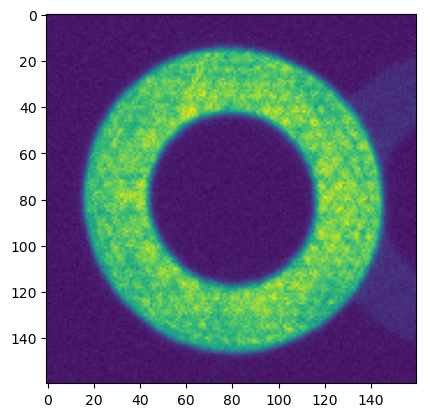

In [18]:
import matplotlib.pyplot as plt
plt.imshow(donutStamps[0].stamp_im.image.array)

In [6]:
donutStamps.metadata.getArray('SIGNAL')

[3422087.983215332, 3275627.9805908203, 3323656.584411621]

In [7]:
donutStamps.metadata.getArray('NOISE')

[132180.39609073766, 82092.20579083152, 98797.7334109098]

In [8]:
donutStamps.metadata.getArray('SN')

[25.88952737640593, 39.90181466115093, 33.64102059495835]

In [50]:
np.array(donutStamps.metadata.getArray('EFFECTIVE')).astype(bool)

array([ True,  True,  True])

In [57]:
import numpy as np
snSelect = np.array(np.asarray(donutStamps.metadata.getArray('SN')) > 35) # .astype(int)

In [72]:
effectiveExtra

array([ True,  True,  True])

In [76]:
from astropy.table import Table

In [82]:
snExtra = np.asarray(donutStamps.metadata.getArray('SN'))

In [ ]:
effectiveExtra

In [83]:
selectExtra = effectiveExtra * snSelectExtra

donutsExtraQuality = Table(data=[snExtra, effectiveExtra, snSelectExtra, selectExtra], 
      names=['SN', 'EFFECTIVE_SELECT', 'SN_SELECT', 'FINAL_SELECT']).to_pandas()

,SN,EFFECTIVE_SELECT,SN_SELECT,FINAL_SELECT
0,25.889527,True,True,True
1,39.901815,True,True,True
2,33.641021,True,False,False


In [85]:
import pandas as pd
effectiveExtra = np.array(donutStamps.metadata.getArray("EFFECTIVE")).astype(bool)

#Table
#donutsExtraQuality = pd.DataFrame(data=[effectiveExtra, snSelect ], columns=['EFFECTIVE'])

In [52]:
effectiveExtra

array([ True, False,  True,  True])

In [60]:
# Donuts are selected individually.
effectiveExtra = np.ones(3, dtype='bool')
effectiveExtra[1] = False


snSelectExtra = np.ones(3, dtype='bool')
snSelectExtra[2] = False

In [61]:
selectExtra = effectiveExtra* snSelectExtra

In [67]:
selectExtra

array([ True, False, False])

In [68]:
len(np.array(donutStamps)[selectExtra])

1

In [63]:
donutStamps[selectExtra]

TypeError: only integer scalar arrays can be converted to a scalar index

In [44]:
snSelect

array([False,  True, False])

In [20]:
np.ones(len(donutStamps), dtype='int')

array([1, 1, 1])

In [29]:
snSelectExtra = np.asarray(donutStampsExtra.metadata.getArray('SN'))

NameError: name 'donutStampsExtra' is not defined

In [33]:
type(snSelect)

numpy.ndarray

In [35]:
len(donutStamps)

3

In [39]:
len(np.array(donutStamps))

3

In [ ]:
snSelect = 

In [45]:
donutStampsSelect = np.array(donutStamps)[snSelect]

In [46]:
len(donutStampsSelect)

1

3

In [21]:
donutStampsExtraSelect = donutStamps[snSelect]
+        #     effectiveCombined.astype(bool)
+        # ]

In [26]:
#plt.imshow(stamp.stamp_im.mask.array)
stamp_mask = stamp.stamp_im.mask.array
image = stamp.stamp_im.image.array

In [55]:
import numpy as np 
donut_mask = np.array((stamp_mask == 512) | (stamp_mask == 1024)).astype(int)
n_px_mask = np.sum(donut_mask)
print(n_px_mask)

9542


## Update the test for `calcZernikes`.... 

In [5]:
from lsst.ts.wep.task import (
    CalcZernikesTask,
    CalcZernikesTaskConfig,
    CombineZernikesMeanTask,
    CombineZernikesSigmaClipTask,
)
config = CalcZernikesTaskConfig()
calcTask = CalcZernikesTask(config=config, name="Base Task")


In [ ]:
calcTask.

In [118]:
zernCoeff = calcTask.estimateZernikes.run(
            donutStampsIntra, donutStampsExtra
        ).zernikes


In [6]:
calcTask.run(donutStampsIntra, donutStampsExtra
        )

INFO:CombineZernikesSigmaClipTask:Using 2 pairs out of 3 in final Zernike estimate.


Struct(outputZernikesAvg=[-0.60847498  0.7937381   0.91901376 -0.10209546  0.01181506  0.02693687
 -0.02237693  0.05141057 -0.04552238 -0.03010653  0.09434553  0.02281202
 -0.0048304   0.00538587  0.00295391  0.02475167  0.00566386 -0.02563173
 -0.01386671]; outputZernikesRaw=[[-5.61752813e-01  7.87529788e-01  7.38174051e-01  2.74421646e-02
   5.32844925e-02  1.66796357e-01 -1.78988640e-02  4.55632679e-02
  -4.18353178e-02 -2.14246473e-02  1.22161227e-01  3.25578297e-02
  -1.42355922e-02 -6.93727667e-03 -1.01134900e-02 -1.43195108e-02
  -4.96860855e-03  2.55504601e-02 -1.42775481e-02]
 [-6.21887775e-01  7.40068428e-01  9.15146455e-01 -8.71868645e-02
  -1.22872204e-03  2.23378549e-02 -1.39262844e-02  5.04924340e-02
  -4.58218196e-02 -2.83011525e-02  1.05586787e-01  1.68284071e-02
  -2.48609730e-03  1.24489563e-03  2.49532242e-03  2.23511828e-02
  -3.44838479e-04 -2.25951198e-02 -1.40605523e-02]
 [-5.95062180e-01  8.47407762e-01  9.22881074e-01 -1.17004058e-01
   2.48588488e-02  3.153588

Change the threshold and show that a donut doesn't pass: 

In [7]:
config = CalcZernikesTaskConfig()


In [8]:
config.signalToNoiseThreshold = 30

In [9]:
calcTask = CalcZernikesTask(config=config, name="Base Task")


In [11]:
struct = calcTask.run(donutStampsIntra, donutStampsExtra
        )

INFO:CombineZernikesSigmaClipTask:Using 2 pairs out of 2 in final Zernike estimate.


In [28]:
len(struct.outputZernikesRaw)

2

In [29]:

len(struct.donutsExtraQuality)

3

In [35]:
colnames = list(struct.donutsIntraQuality.columns)
colnames

['SN', 'EFFECTIVE_SELECT', 'SN_SELECT', 'FINAL_SELECT']

In [36]:
desired_colnames = ['SN_SELECT',  'EFFECTIVE_SELECT',  'SN', 'FINAL_SELECT'] 

In [39]:
import numpy as np 
np.testing.assert_array_equal(np.sort(colnames), np.sort(desired_colnames))

So this shows that the first donut (both intra and extra focal) did not make it in the final selection. 

In [14]:
len(struct)

4

In [16]:
len(struct.donutsExtraQuality)

3

# Use wfs_grid : donuts with decreasing S/N 

Now test that the new `calcZernikes`  filters out messy donuts:

In [41]:
import lsst.daf.butler as dafButler

path_cwd = '/sdf/group/rubin/shared/scichris/DM-43524_grid/wfs_grid4'
butlerRootPath = os.path.join(path_cwd, 'imsimData')
butler = dafButler.Butler(butlerRootPath)

registry = butler.registry

datasetRefs = registry.queryDatasets("postISRCCD",collections=['ts_imsim_1000'],
              ).expanded()

In [52]:

exposure_extra = butler.get('postISRCCD', dataId=dataIdExtra, collections=['ts_imsim_1000'])
exposure_intra = butler.get('postISRCCD', dataId=dataIdIntra, collections=['ts_imsim_1000'])


In [42]:
import astropy.units as u

data = {}

# just four corner WFS 
for detExtra in  [191]:#, 195, 199, 203 ]:

    data[detExtra] = {}
    dataIdExtra = {'instrument': 'LSSTCam', 'detector': detExtra, 'exposure': 7023062001000, 'visit':7023062001000}
    dataIdIntra = {'instrument': 'LSSTCam', 'detector': detExtra+1, 'exposure': 7023062001000, 'visit':7023062001000}
    data[detExtra]['dataIdExtra']=dataIdExtra
    data[detExtra]['dataIdIntra']=dataIdIntra
    exposure_extra = butler.get('postISRCCD', dataId=dataIdExtra, collections=['ts_imsim_1000'])
    data[detExtra]['exposure_extra'] = exposure_extra
    
    # print(exposure_extra.getDetector().getName())

    collection = 'ts_imsim_1000'
    donutStampsExtra = butler.get('donutStampsExtra', 
                              dataId=dataIdExtra, 
                              collections=[collection])  
    
    donutStampsIntra = butler.get('donutStampsIntra', 
                              dataId=dataIdExtra, 
                              collections=[collection])  
    data[detExtra]['donutStampsExtra'] = donutStampsExtra
    data[detExtra]['donutStampsIntra'] = donutStampsIntra
    
    #collection = 'ts_imsim_1000_var'
    
    
    donutCatalogExtra = butler.get('donutCatalog', 
                              dataId=dataIdExtra, 
                              collections=[collection])  
    
    donutCatalogIntra = butler.get('donutCatalog', 
                              dataId=dataIdIntra, 
                              collections=[collection]) 
    
    data[detExtra]['donutCatalogExtra'] = donutCatalogExtra
    data[detExtra]['donutCatalogIntra'] = donutCatalogIntra
    
    #zkEstimateRaw = butler.get('zernikeEstimateRaw', 
    #                          dataId=dataIdExtra, 
    #                          collections=[collection])
    #data[detExtra]['zkEstimateRaw'] = zkEstimateRaw
    
    # calculate the AB magnitudes 
    
    donutCatalogExtra['mag'] = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)
    donutCatalogIntra['mag'] = (donutCatalogIntra['source_flux'].values * u.nJy).to_value(u.ABmag)

    data[detExtra]['donutCatalogExtra'] = donutCatalogExtra
    data[detExtra]['donutCatalogIntra'] = donutCatalogIntra

In [44]:
donutStampsExtra

In [45]:
config = CalcZernikesTaskConfig()
calcTask = CalcZernikesTask(config=config, name="Base Task")


In [47]:
calcTask.config

lsst.ts.wep.task.calcZernikesTask.CalcZernikesTaskConfig(saveLogOutput=True, estimateZernikes={'instConfigFile': None, 'maxNollIndex': 22, 'startWithIntrinsic': True, 'returnWfDev': False, 'return4Up': True, 'units': 'um', 'usePairs': True, 'saveHistory': False, 'opticalModel': 'offAxis', 'maxIter': 30, 'compSequence': [4, 4, 6, 6, 13, 13, 13, 13, 22, 22, 22, 22], 'compGain': 0.6, 'centerTol': 1e-09, 'centerBinary': True, 'convergeTol': 1e-09, 'maskKwargs': {}}, combineZernikes={'sigma': 3.0, 'stdMin': 0.005, 'maxZernClip': 3}, selectWithEntropy=True, selectWithSignalToNoise=True, signalToNoiseThreshold=20.0, connections={'donutStampsExtra': 'donutStampsExtra', 'donutStampsIntra': 'donutStampsIntra', 'outputZernikesRaw': 'zernikeEstimateRaw', 'outputZernikesAvg': 'zernikeEstimateAvg', 'donutsExtraQuality': 'donutsExtraQuality', 'donutsIntraQuality': 'donutsIntraQuality'})

In [48]:
struct = calcTask.run(donutStampsExtra, donutStampsIntra)

KeyError: 'SN not found'

Ok, this is because the donuts were cutout with previous version of cutout donuts base.... Run that in notebook to demonstrate:

In [49]:
from lsst.ts.wep.task.cutOutDonutsCwfsTask import (
    CutOutDonutsCwfsTask, CutOutDonutsCwfsTaskConfig)


In [50]:
cutoutTaskConfig = CutOutDonutsCwfsTaskConfig()
cutoutTask = CutOutDonutsCwfsTask(config=cutoutTaskConfig)


In [54]:
camera = butler.get(
    "camera",
    dataId={"instrument": "LSSTCam"},
    collections=["LSSTCam/calib/unbounded",],
)

In [55]:
cutouts = cutoutTask.run([exposure_extra, exposure_intra],
                         [donutCatalogExtra,donutCatalogIntra],
                         camera)
                         

In [57]:
len(cutouts.donutStampsExtra)

66

In [60]:
list(cutouts.donutStampsExtra.metadata)

['RA_DEG',
 'DEC_DEG',
 'DET_NAME',
 'CAM_NAME',
 'DFC_TYPE',
 'DFC_DIST',
 'CENT_X',
 'CENT_Y',
 'BLEND_CX',
 'BLEND_CY',
 'X0',
 'Y0',
 'SN',
 'SIGNAL',
 'NOISE',
 'EFFECTIVE']

ok, the new cutouts have the desired quantities. Run calc Zernikes: 

In [61]:
config = CalcZernikesTaskConfig()
calcTask = CalcZernikesTask(config=config, name="Base Task")
calcTask.config



lsst.ts.wep.task.calcZernikesTask.CalcZernikesTaskConfig(saveLogOutput=True, estimateZernikes={'instConfigFile': None, 'maxNollIndex': 22, 'startWithIntrinsic': True, 'returnWfDev': False, 'return4Up': True, 'units': 'um', 'usePairs': True, 'saveHistory': False, 'opticalModel': 'offAxis', 'maxIter': 30, 'compSequence': [4, 4, 6, 6, 13, 13, 13, 13, 22, 22, 22, 22], 'compGain': 0.6, 'centerTol': 1e-09, 'centerBinary': True, 'convergeTol': 1e-09, 'maskKwargs': {}}, combineZernikes={'sigma': 3.0, 'stdMin': 0.005, 'maxZernClip': 3}, selectWithEntropy=True, selectWithSignalToNoise=True, signalToNoiseThreshold=20.0, connections={'donutStampsExtra': 'donutStampsExtra', 'donutStampsIntra': 'donutStampsIntra', 'outputZernikesRaw': 'zernikeEstimateRaw', 'outputZernikesAvg': 'zernikeEstimateAvg', 'donutsExtraQuality': 'donutsExtraQuality', 'donutsIntraQuality': 'donutsIntraQuality'})

In [62]:
struct = calcTask.run(cutouts.donutStampsExtra, cutouts.donutStampsIntra)

INFO:CombineZernikesSigmaClipTask:Using 19 pairs out of 19 in final Zernike estimate.


In [63]:
struct

Struct(outputZernikesAvg=[-0.2216146   0.01676086  0.13956561  0.04302852 -0.05044766 -0.164919
  0.03344927 -0.01982069  0.00726973  0.01116613  0.009308    0.04235053
  0.00619115  0.01442442 -0.02552559  0.01412598  0.00504479  0.00392119
 -0.00547582]; outputZernikesRaw=[[-2.49397472e-01 -2.85661527e-02  3.10378188e-02 -2.72367278e-03
  -7.34920172e-02 -7.23494120e-02  1.86904145e-02 -2.29091136e-02
   1.31564696e-02 -9.33636090e-03  6.40859029e-02  2.60943143e-03
   1.91633554e-02  3.03992979e-02 -2.61645960e-02  1.80100640e-02
  -3.23823586e-02 -1.04160032e-02 -5.22534267e-03]
 [-2.40945936e-01  1.15372582e-02  1.15876170e-01  4.78357106e-03
  -1.27842438e-01 -1.48981745e-01  4.06253650e-02 -2.35808652e-02
   7.97147442e-03  3.10803832e-03  1.22328810e-02  2.90986917e-02
   2.31273821e-02  2.46948135e-02 -2.55628599e-02  1.52490050e-02
  -4.65440210e-03  6.45479825e-03 -6.23037902e-03]
 [-2.26225022e-01  2.08471311e-02  5.64074742e-02 -9.97135793e-03
  -2.41475306e-02 -1.08814248

In [64]:
struct.donutsExtraQuality

,SN,EFFECTIVE_SELECT,SN_SELECT,FINAL_SELECT
0,94.992604,True,True,True
1,90.450312,True,True,True
2,76.079168,True,True,True
3,76.373660,True,True,True
4,71.010531,True,True,True
...,...,...,...,...
61,0.541604,False,False,False
62,0.499872,False,False,False
63,0.400798,False,False,False
64,0.340497,False,False,False


## Test for an empty stamp and a dense field: use LSSTCam sweep data

In [68]:
import lsst.daf.butler as dafButler
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/'
butlerRootPath = os.path.join(path_cwd, 'gen3repo')

butler = dafButler.Butler(butlerRootPath)
registry = butler.registry
#collection = 'runFAM_960_962_det93-94_2023_47_ext_lim_11-15'
#collection = 'runFAM_det93-94_2023_47_ext_lim_13-17' 
#collection = 'runFAM_det93-94_2023_47_ext_1'
#collection = 'runFAM_det160-161_2023_47_ext_1'
#collection = 'runFAM_det160-161_1' # with different mag limits ... 7 to 15 
collection = 'runFAM_960_962_all_det_2023_47_ext_lim_11-15_bps'
datasetRefs = registry.queryDatasets("s",collections=[collection],
              where=f"instrument='LSSTCam'").expanded()
refs = []
for ref in datasetRefs:
    #print(ref)
    refs.append(ref)

In [95]:
data_id = refs[34].dataId
data_id

{instrument: 'LSSTCam', detector: 34, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}

In [69]:
# postISR collection
inputRun = 'run_739388'

In [96]:
detector = 34
instrument = 'LSSTCam'
exposure_extra = 5028081800962
exposure_intra = 5028081800960
# construct a dataId for zernikes and donut catalog:
# switch exposure to visit
data_id_extra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_extra,
           "exposure":exposure_extra
          }

data_id_intra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_intra,
           "exposure":exposure_intra
          }

In [73]:
#butler.get("postISRCCD", dataId=data_id, collections=[inputRun])


In [97]:
exposure_intra = butler.get("postISRCCD", dataId=data_id_intra, collections=[inputRun])
exposure_extra = butler.get("postISRCCD", dataId=data_id_extra, collections=[inputRun])


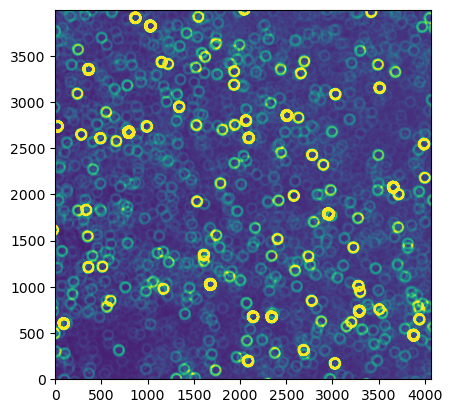

In [98]:
import matplotlib.pyplot as plt 
from astropy.visualization import ZScaleInterval
zscale = ZScaleInterval()

d = exposure_intra.image.array
vmin,vmax = zscale.get_limits(d)

plt.imshow(d, vmin=vmin, vmax=vmax,  origin='lower', )

In [100]:
collection = 'runFAM_960_962_all_det_2023_47_ext_lim_11-15_bps'
#collection='runFAM_det160-161_1'
donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
print(len(donutCatalogExtra))


donutCatalogIntra = butler.get("donutCatalog", dataId=data_id_intra, collections=[collection])
print(len(donutCatalogIntra))

13
13


In [87]:
donutCatalogExtra

,coord_ra,coord_dec,centroid_x,centroid_y,source_flux,blend_centroid_x,blend_centroid_y
0,4.807335,-0.098934,2799.599979,2967.369304,4.995477e+07,[],[]
1,4.806922,-0.100051,1572.268194,2980.704541,3.506737e+07,[],[]
2,4.805696,-0.099572,1586.581350,1628.244795,3.081729e+07,[],[]
3,4.805755,-0.099808,1381.188701,1772.106027,2.740601e+07,[],[]
4,4.806204,-0.101076,322.235425,2667.658201,2.189553e+07,[],[]
5,4.806267,-0.100034,1350.026467,2345.476505,2.032895e+07,[],[]
6,4.805034,-0.098667,2218.007703,661.777289,1.911715e+07,[],[]
7,4.807480,-0.099234,2563.182564,3215.650510,1.874734e+07,[],[]
8,4.807041,-0.098052,3543.225975,2361.521428,1.570317e+07,[],[]
9,4.804925,-0.099895,994.594186,1007.430138,1.451760e+07,[],[]


Use these to create cutouts: 

In [101]:
cutouts = cutoutTask.run([exposure_extra, exposure_intra],
                         [donutCatalogExtra,donutCatalogIntra],
                         camera)
                         

In [102]:
len(cutouts.donutStampsExtra)

13

In [103]:
list(cutouts.donutStampsExtra.metadata)

['RA_DEG',
 'DEC_DEG',
 'DET_NAME',
 'CAM_NAME',
 'DFC_TYPE',
 'DFC_DIST',
 'CENT_X',
 'CENT_Y',
 'BLEND_CX',
 'BLEND_CY',
 'X0',
 'Y0',
 'SN',
 'SIGNAL',
 'NOISE',
 'EFFECTIVE']

In [104]:
donutStampsExtra = cutouts.donutStampsExtra
donutStampsIntra = cutouts.donutStampsIntra


ok, so each donut got all  these calculated. Display the stamps to see if there are any unusual ones:

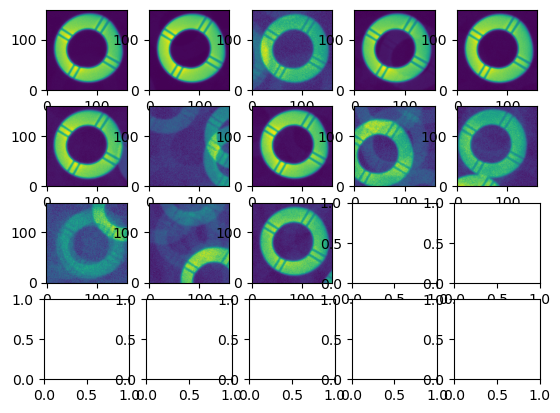

In [105]:
fig,axs = plt.subplots(4,5)
ax = np.ravel(axs)
for i in range(len(donutStampsExtra)):
    ax[i].imshow(donutStampsExtra[i].stamp_im.image.array, origin='lower')

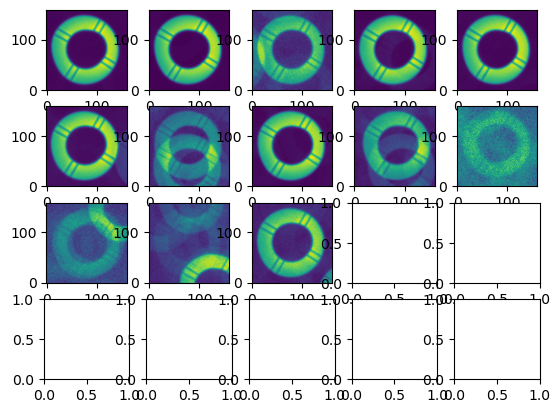

In [109]:
fig,axs = plt.subplots(4,5)
ax = np.ravel(axs)
for i in range(len(donutStampsExtra)):
    ax[i].imshow(donutStampsIntra[i].stamp_im.image.array, origin='lower')

In [106]:
sn = donutStampsExtra.metadata.getArray('SN')
effective = donutStampsExtra.metadata.getArray('EFFECTIVE')

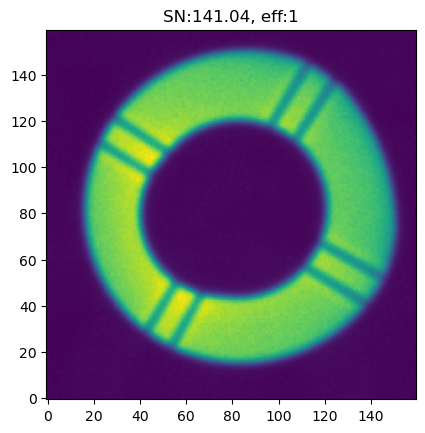

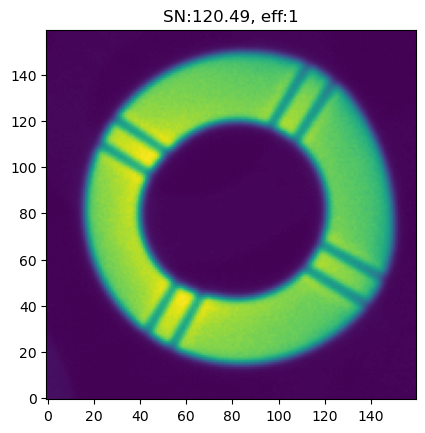

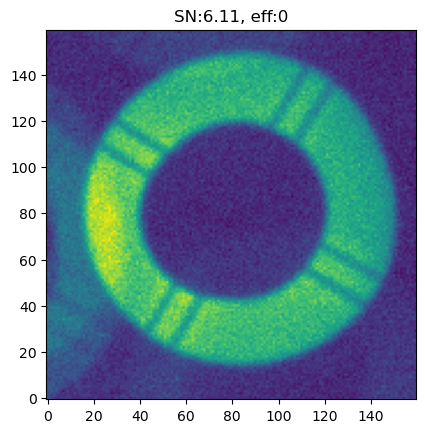

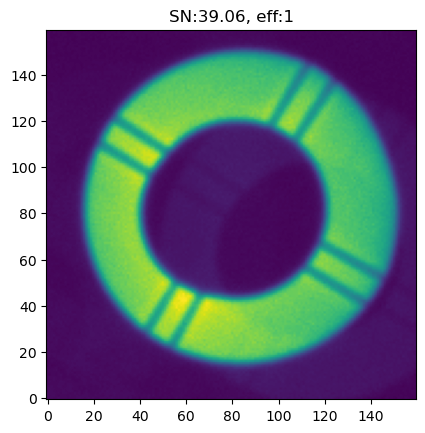

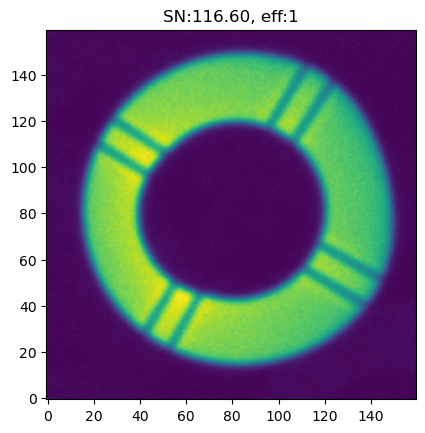

...

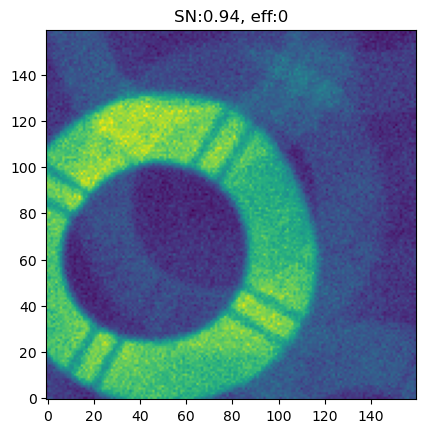

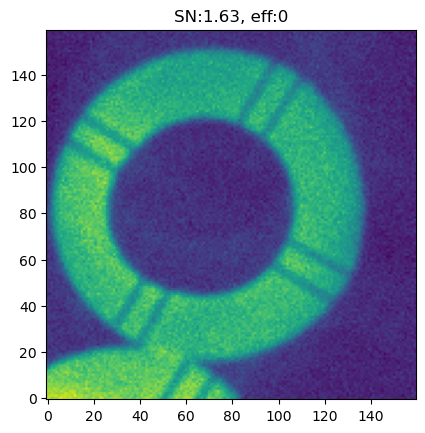

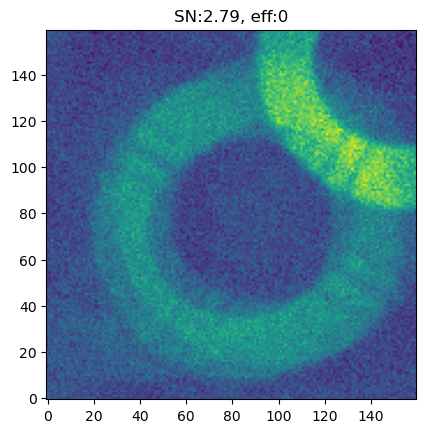

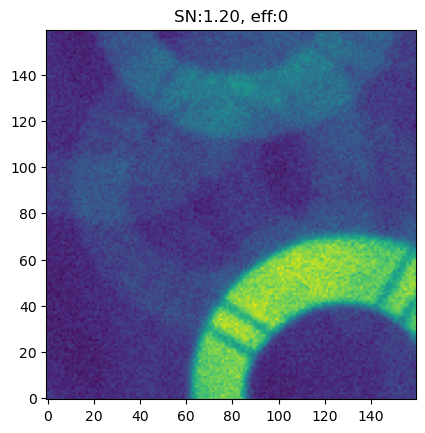

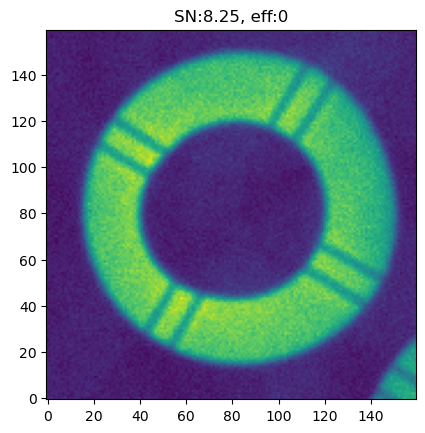

In [108]:
for i in range(len(donutStampsExtra)):
    plt.imshow(donutStampsExtra[i].stamp_im.image.array, origin='lower')
    plt.title(f'donut{i},  SN:{sn[i]:.2f}, eff:{effective[i]}')
    plt.show()

We can also show the intra-focal donuts : 

In [110]:
sn = donutStampsIntra.metadata.getArray('SN')
effective = donutStampsIntra.metadata.getArray('EFFECTIVE')

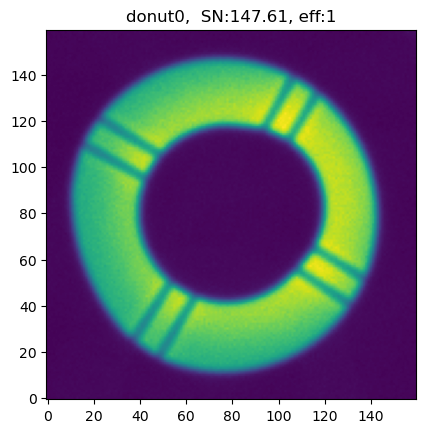

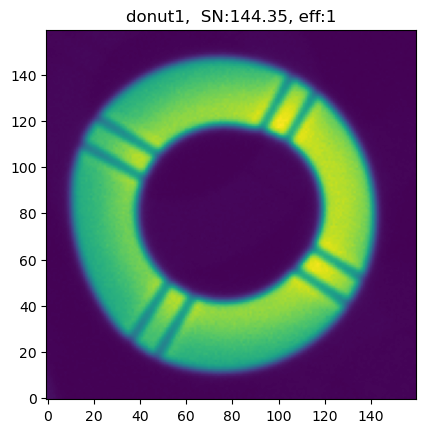

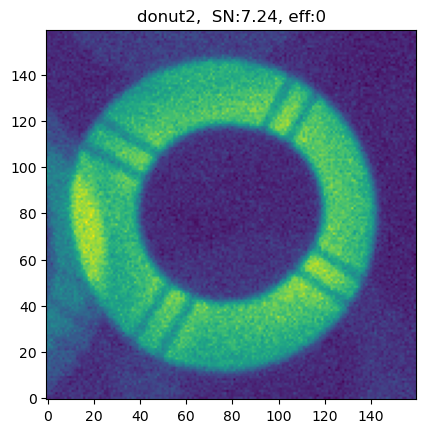

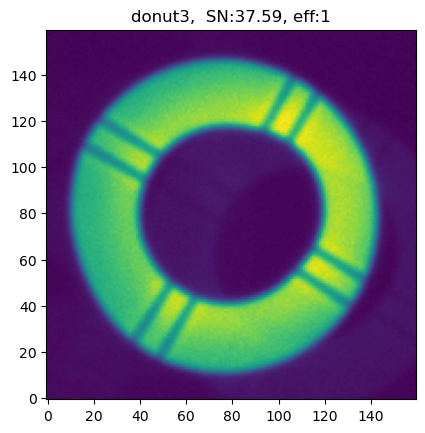

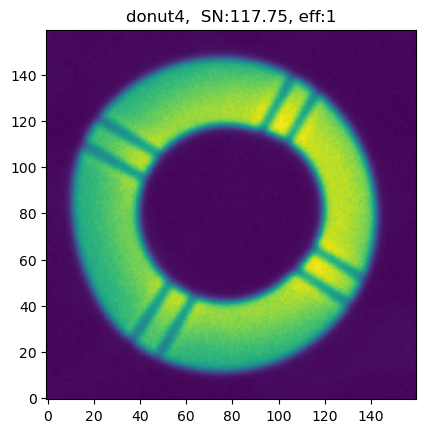

...

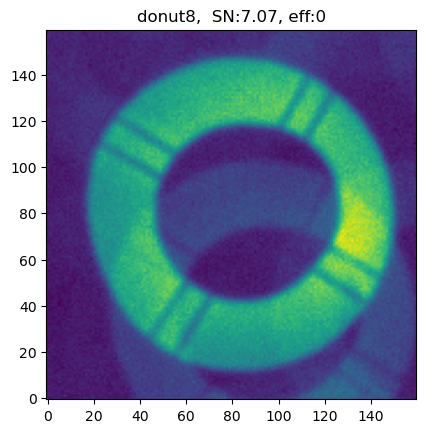

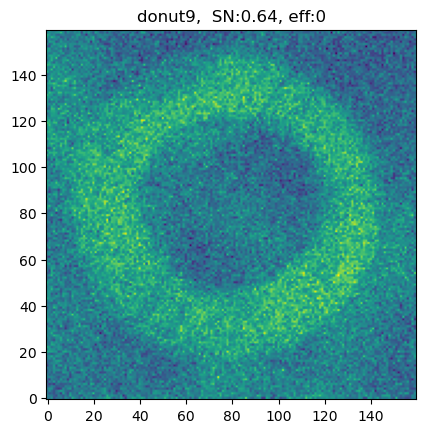

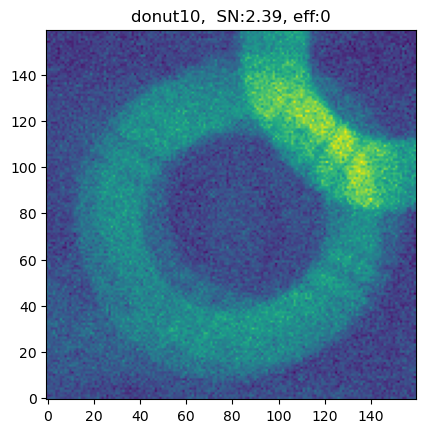

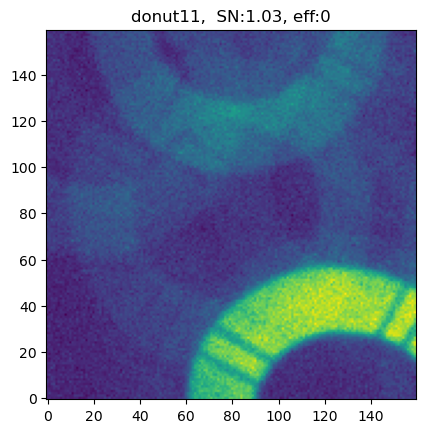

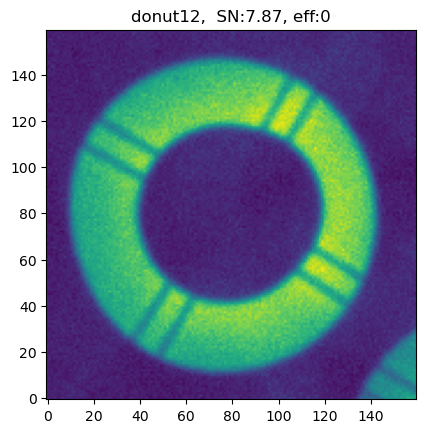

In [111]:
for i in range(len(donutStampsIntra)):
    plt.imshow(donutStampsIntra[i].stamp_im.image.array, origin='lower')
    plt.title(f'donut{i},  SN:{sn[i]:.2f}, eff:{effective[i]}')
    plt.show()

ok, try some of these - would they get singled out for calcZernikes:

In [112]:
config = CalcZernikesTaskConfig()
calcTask = CalcZernikesTask(config=config, name="Base Task")
calcTask.config

lsst.ts.wep.task.calcZernikesTask.CalcZernikesTaskConfig(saveLogOutput=True, estimateZernikes={'instConfigFile': None, 'maxNollIndex': 22, 'startWithIntrinsic': True, 'returnWfDev': False, 'return4Up': True, 'units': 'um', 'usePairs': True, 'saveHistory': False, 'opticalModel': 'offAxis', 'maxIter': 30, 'compSequence': [4, 4, 6, 6, 13, 13, 13, 13, 22, 22, 22, 22], 'compGain': 0.6, 'centerTol': 1e-09, 'centerBinary': True, 'convergeTol': 1e-09, 'maskKwargs': {}}, combineZernikes={'sigma': 3.0, 'stdMin': 0.005, 'maxZernClip': 3}, selectWithEntropy=True, selectWithSignalToNoise=True, signalToNoiseThreshold=20.0, connections={'donutStampsExtra': 'donutStampsExtra', 'donutStampsIntra': 'donutStampsIntra', 'outputZernikesRaw': 'zernikeEstimateRaw', 'outputZernikesAvg': 'zernikeEstimateAvg', 'donutsExtraQuality': 'donutsExtraQuality', 'donutsIntraQuality': 'donutsIntraQuality'})

In [113]:
struct = calcTask.run(cutouts.donutStampsExtra, cutouts.donutStampsIntra)

INFO:CombineZernikesSigmaClipTask:Using 2 pairs out of 5 in final Zernike estimate.


In [115]:
struct.donutsExtraQuality

,SN,EFFECTIVE_SELECT,SN_SELECT,FINAL_SELECT
0,141.041212,True,True,True
1,120.490457,True,True,True
2,6.110610,False,False,False
3,39.055006,True,True,True
4,116.595358,True,True,True
5,20.884094,True,True,True
6,0.905718,False,False,False
7,65.371571,True,True,True
8,0.943984,False,False,False
9,1.626682,False,False,False


ok, looks like it works just fine.  Run it on all detectors via bps. First write the config yaml using the WEP:

In [116]:
from lsst.ts.imsim.utils import (
    CamType,
    SensorWavefrontError,
    WepEstimator,
    get_camera,
    get_config_dir,
    make_dir,
    plot_fwhm_of_iters,
)

wep_estimator_method = 'tie' # or 'danish'
wep_estimator = WepEstimator(wep_estimator_method)

In [118]:
wep_estimator.value.title()

'Tie'

Note: in this need to change the name of the reference catalog, so that instead of the default `cal_ref_cat` , the `generateDonutCatalogWcsTask` is looking for:

       generateDonutCatalogWcsTask:
        class: lsst.ts.wep.task.generateDonutCatalogWcsTask.GenerateDonutCatalogWcsTask
        config:
          connections.refCatalogs: gaia_dr2_20200414
          anyFilterMapsToThis: phot_g_mean

Note:  also it is needed to set custom mag limits, because otherwise it is trying to do 

     File "/sdf/data/rubin/user/scichris/WORK/aos_packages/ts_wep/python/lsst/ts/wep/task/donutSourceSelectorTask.py", line 214, in selectSources
    magMax = magPolicyDefaults[defaultFilterKey]["high"]
             ~~~~~~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^
    KeyError: 'filterPHOT_G_MEAN'

which is nonsense.. see `/sdf/group/rubin/shared/scichris/DM-41957_lsstCam_sweep/submit/runFAM_960_962_all_det_2024_13_ext_lim_11-15_bps_science_93-94/20240426T002024Z/jobs/generateDonutCatalogWcsTask/5028081800960/13eca495-19eb-465b-98d2-b364bc803c09_generateDonutCatalogWcsTask_5028081800960_94.8544577.err`


so `generateDonutCatalogWcsTask` also needs : 



In [123]:


cam_type = CamType.LsstFamCam
pipeline_yaml_path = '/sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/lsstPipelineWEP_lsstfam_refactor.yaml'
def write_wep_config_yaml(
        cam_type: CamType,
        pipeline_yaml_path: str,
        wep_estimator: WepEstimator,
    ) -> None:
        """Write wavefront estimation pipeline task configuration.

        Parameters
        ----------
        cam_type : lsst.ts.imsim.utils.CamType
            Camera type.
        pipeline_yaml_path : str
            Path where the pipeline task configuration yaml file
            should be saved.
        filter_type_name : str
            Filter type name: ref (or ''), u, g, r, i, z, or y.
        wep_estimator : enum 'WepEstimator' in lsst.ts.wep.utility
            Specify the method used to calculate Zernikes in ts_wep.
        """
        max_noll_index = 28
        #butler_inst_name = self._get_butler_inst_name(cam_type)
        if cam_type in [CamType.LsstCam, CamType.LsstFamCam]:
            butler_inst_name = "Cam"
        elif cam_type == CamType.ComCam:
            butler_inst_name = "ComCamSim"
            
        # Remap reference filter
        #filter_type_name = "g" if filter_type_name in ("ref", "") else filter_type_name

        # Set defocal offset for camera
        if cam_type in [CamType.LsstCam, CamType.LsstFamCam]:
            if cam_type == CamType.LsstCam:
                cut_out_task = "Cwfs"
            else:
                cut_out_task = "ScienceSensor"
        elif cam_type in [CamType.ComCam]:
            cut_out_task = "ScienceSensor"

        with open(pipeline_yaml_path, "w") as fp:
            fp.write(
                f"""# This yaml file is used to define the tasks and configuration of
# a Gen 3 pipeline used for testing in ts_wep.
description: wep basic processing test pipeline
# Here we specify the corresponding instrument for the data we
# will be using.
instrument: lsst.obs.lsst.Lsst{butler_inst_name}
# Then we can specify each task in our pipeline by a name
# and then specify the class name corresponding to that task
tasks:
  isr:
    class: lsst.ip.isr.isrTask.IsrTask
    # Below we specify the configuration settings we want to use
    # when running the task in this pipeline. Since our data doesn't
    # include bias or flats we only want to use doApplyGains and
    # doOverscan in our isr task.
    config:
      connections.outputExposure: 'postISRCCD'
      doBias: False
      doVariance: False
      doLinearize: False
      doCrosstalk: False
      doDefect: False
      doNanMasking: False
      doInterpolate: False
      doBrighterFatter: False
      doDark: False
      doFlat: False
      doApplyGains: True
      doFringe: False
      doOverscan: True
      python: OverscanCorrectionTask.ConfigClass.fitType = 'MEDIAN'
  generateDonutCatalogWcsTask:
    class: lsst.ts.wep.task.generateDonutCatalogWcsTask.GenerateDonutCatalogWcsTask
  cutOutDonuts{cut_out_task}Task:
    class: lsst.ts.wep.task.cutOutDonuts{cut_out_task}Task.CutOutDonuts{cut_out_task}Task
  calcZernikesTask:
    class: lsst.ts.wep.task.calcZernikesTask.CalcZernikesTask
    config:
      estimateZernikes.maxNollIndex: {max_noll_index}
      python: |
        from lsst.ts.wep.task import EstimateZernikesTieTask, EstimateZernikesDanishTask
        config.estimateZernikes.retarget(EstimateZernikes{wep_estimator.value.title()}Task)
"""
            )

In [124]:
write_wep_config_yaml(
        cam_type = cam_type,
        pipeline_yaml_path=pipeline_yaml_path,
        wep_estimator=wep_estimator)

In [ ]:
from lsst.ts.wep.task.cutOutDonutsCwfsTask import  CutOutDonutsCwfsTask

Test the butler query:

In [ ]:
butler query-datasets --collections run_739388 --where "instrument='LSSTCam'" /sdf/group/rubin/shared/scichris/DM-42718_WET-006/gen3repo

    cd /sdf/group/rubin/shared/scichris/DM-41957_lsstCam_sweep/

    allocateNodes.py -v -n 10 -c 32 -m 6:00:00 -q roma,milano -g 900 s3df --account rubin:commissioning

    bps submit site_bps.yaml -b  /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/gen3repo -i refcats/gaia_dr2_20200414,run_739388,LSSTCam/calib/unbounded  -o runFAM_960_962_2024_13_ext_bps_93-94  -p /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/lsstPipelineWEP_lsstfam_refactor_noISR.yaml -d "exposure.seq_num in (960,962) and detector in (93,94)"

    bps report --id 8544574.0


    cd submit/runFAM_960_962_all_det_2024_13_ext_lim_11-15_bps_science_93-94/

But worryingly `pipetaskInit`     is stuck in `pending` status ... Why ?   (needed to rerun `allocate_nodes`... ) 


    bps report --id 8544581.0

                                  UNKNOWN MISFIT UNREADY READY PENDING RUNNING DELETED HELD SUCCEEDED FAILED PRUNED EXPECTED
    ----------------------------- ------- ------ ------- ----- ------- ------- ------- ---- --------- ------ ------ --------
    TOTAL                               0      0       0     0       0       0       0    0        12      0      0       12
    ----------------------------- ------- ------ ------- ----- ------- ------- ------- ---- --------- ------ ------ --------
    pipetaskInit                        0      0       0     0       0       0       0    0         1      0      0        1
    generateDonutCatalogWcsTask         0      0       0     0       0       0       0    0         4      0      0        4
    cutOutDonutsScienceSensorTask       0      0       0     0       0       0       0    0         2      0      0        2
    calcZernikesTask                    0      0       0     0       0       0       0    0         4      0      0        4
    finalJob                            0      0       0     0       0       0       0    0         1      0      0        1        

All succeeded! Have a look at the data products:

In [133]:
butler = dafButler.Butler(butlerRootPath)
registry = butler.registry

collection = 'runFAM_960_962_2024_13_ext_bps_93-94'
datasetRefs = registry.queryDatasets("donutStampsExtra",collections=[collection],
              where=f"instrument='LSSTCam'").expanded()
refs = []
for ref in datasetRefs:
    #print(ref)
    refs.append(ref)

In [134]:
refs

[DatasetRef(DatasetType('donutStampsExtra', {band, instrument, detector, physical_filter, visit}, StampsBase), {instrument: 'LSSTCam', detector: 93, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}, run='runFAM_960_962_2024_13_ext_bps_93-94/20240426T003902Z', id=9ca21599-3034-4405-8e81-9eae909fcb32),
 DatasetRef(DatasetType('donutStampsExtra', {band, instrument, detector, physical_filter, visit}, StampsBase), {instrument: 'LSSTCam', detector: 94, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}, run='runFAM_960_962_2024_13_ext_bps_93-94/20240426T003902Z', id=c2bf38fc-42e2-4e60-98cc-4ef6eac7ed7c)]

In [137]:
datasetRefs = registry.queryDatasets("donutStampsIntra",collections=[collection],
              where=f"instrument='LSSTCam'").expanded()
refs = []
for ref in datasetRefs:
    #print(ref)
    refs.append(ref)

In [138]:
refs

[DatasetRef(DatasetType('donutStampsIntra', {band, instrument, detector, physical_filter, visit}, StampsBase), {instrument: 'LSSTCam', detector: 93, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}, run='runFAM_960_962_2024_13_ext_bps_93-94/20240426T003902Z', id=cb72add5-cd99-45b2-8802-56d37fef2fc6),
 DatasetRef(DatasetType('donutStampsIntra', {band, instrument, detector, physical_filter, visit}, StampsBase), {instrument: 'LSSTCam', detector: 94, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}, run='runFAM_960_962_2024_13_ext_bps_93-94/20240426T003902Z', id=7fc25351-edbb-45b7-ad2f-a07347f0e199)]

In [209]:
detector = 94
instrument = 'LSSTCam'
exposure_extra = 5028081800962
exposure_intra = 5028081800962
# construct a dataId for zernikes and donut catalog:
# switch exposure to visit
data_id_extra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_extra,
           "exposure":exposure_extra
          }

data_id_intra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_intra,
           "exposure":exposure_intra
          }



donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])
print(len(donutCatalogExtra))

donutStampsIntra = butler.get("donutStampsIntra", dataId=data_id_intra, collections=[collection])
print(len(donutStampsIntra))

donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
print(len(donutCatalogExtra))

donutCatalogIntra = butler.get("donutCatalog", dataId=data_id_intra, collections=[collection])
print(len(donutCatalogIntra))



22
23
23
23


In [141]:
n = donutStampsExtra.metadata.getArray('SN')
effective = donutStampsExtra.metadata.getArray('EFFECTIVE')



In [143]:
effective

[1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0]

In [210]:
donutsExtraQuality = butler.get("donutsExtraQuality", dataId=data_id_extra, collections=[collection])

In [211]:
donutsIntraQuality = butler.get("donutsIntraQuality", dataId=data_id_intra, collections=[collection])

In [188]:
#donutsExtraQuality['SN']

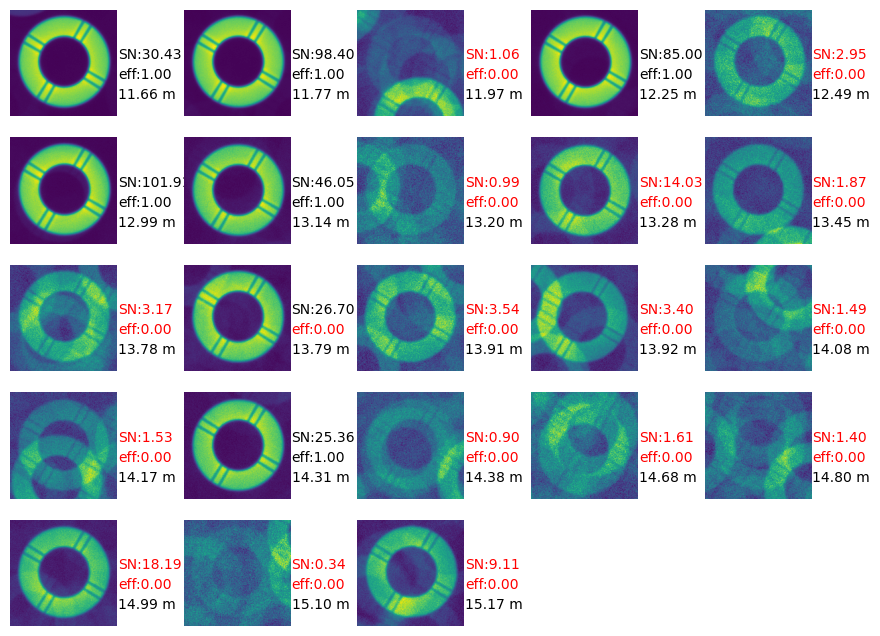

In [212]:
fig,axs = plt.subplots(5,5, figsize=(11,8))
ax = np.ravel(axs)

mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)

n = len(donutStampsExtra)
for i in range(len(donutStampsExtra)):
    ax[i].imshow(donutStampsExtra[i].stamp_im.image.array, origin='lower')
    color = 'black' 
    sn = donutsExtraQuality['SN'][i]
    if sn < 20:
        color='red'
    ax[i].text(162,85,f"SN:{sn:.2f}", color=color)

    en = donutsExtraQuality['EFFECTIVE_SELECT'][i]
    color = 'black' 
    if not en:
        color='red'
    ax[i].text(162,55,f"eff:{en:.2f}", color=color)
    ax[i].text(162,25, f"{mags[i]:.2f} m")
    ax[i].axis('off')
if n < len(ax):  
    for j in range(n, len(ax)):
        ax[j].axis('off')
fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0.1)

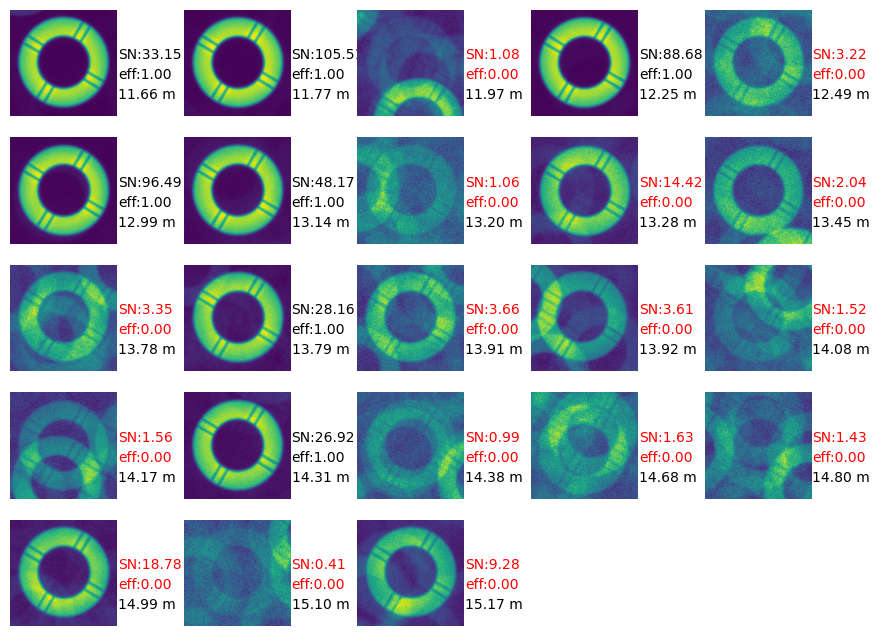

In [213]:
fig,axs = plt.subplots(5,5, figsize=(11,8))
ax = np.ravel(axs)

mags = (donutCatalogIntra['source_flux'].values * u.nJy).to_value(u.ABmag)

n = len(donutStampsIntra)
for i in range(len(donutStampsIntra)):
    ax[i].imshow(donutStampsIntra[i].stamp_im.image.array, origin='lower')
    color = 'black' 
    sn = donutsIntraQuality['SN'][i]
    if sn < 20:
        color='red'
    ax[i].text(162,85,f"SN:{sn:.2f}", color=color)

    en = donutsIntraQuality['EFFECTIVE_SELECT'][i]
    color = 'black' 
    if not en:
        color='red'
    ax[i].text(162,55,f"eff:{en:.2f}", color=color)
    ax[i].text(162,25, f"{mags[i]:.2f} m")
    ax[i].axis('off')
if n < len(ax):  
    for j in range(n, len(ax)):
        ax[j].axis('off')
fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0.1)

In [214]:
zkRaw = butler.get("zernikeEstimateRaw", dataId=data_id_extra, collections=[collection])

In [215]:
len(donutsExtraQuality[donutsExtraQuality['FINAL_SELECT']==True])

6

In [216]:
len(donutsIntraQuality[donutsIntraQuality['FINAL_SELECT']==True])

7

In [217]:
len(zkRaw)

6

Plot the entropy histogram:

In [269]:
donutsExtraQuality

,SN,EFFECTIVE_SELECT,SN_SELECT,FINAL_SELECT
0,301.131202,True,True,True
1,258.988070,True,True,True
2,20.743469,True,True,True
3,2.408377,False,False,False
4,44.837689,True,True,True
5,34.869367,True,True,True
6,2.293678,False,False,False
7,0.488465,True,False,False
8,41.577075,True,True,True
9,12.232125,False,False,False


In [262]:
import scipy 
def calculate_entropy(stamp):
    d = stamp.stamp_im.image.array
    # these follow code from https://github.com/lsst-ts/ts_wep/blob/develop/python/lsst/ts/wep/donutImageCheck.py
    array1d = d.flatten()
    #entroThres = 3.5
    numOfBins = 256
    hist, edges = np.histogram(array1d, bins=numOfBins)
    
    # Square the distribution to magnify the difference in entropy
    imgEntropy = scipy.stats.entropy(hist**2)
    
    return imgEntropy, hist, edges, 

/tmp/ipykernel_42201/1794602806.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(9,3))#1, figsize=(3*edge, n_donuts*edge))


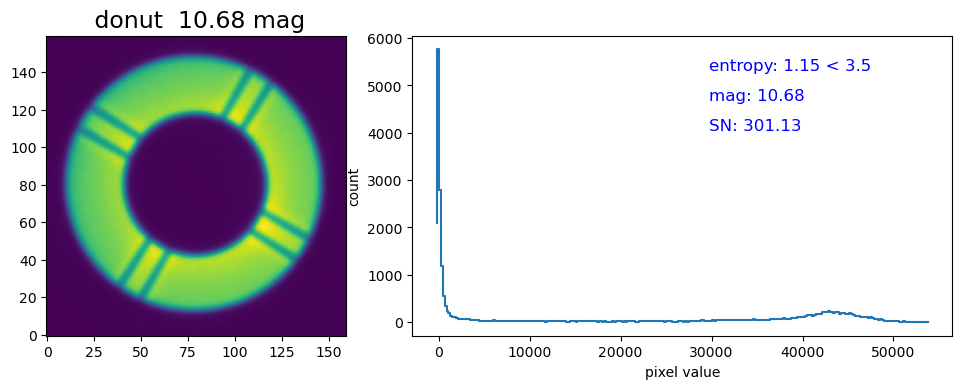

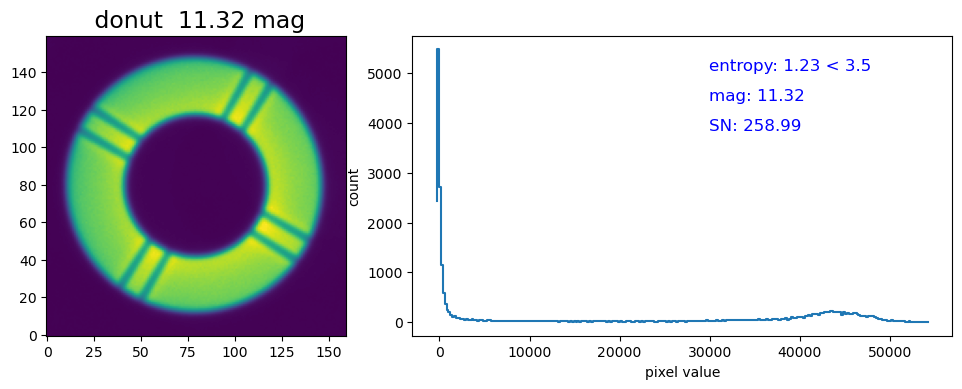

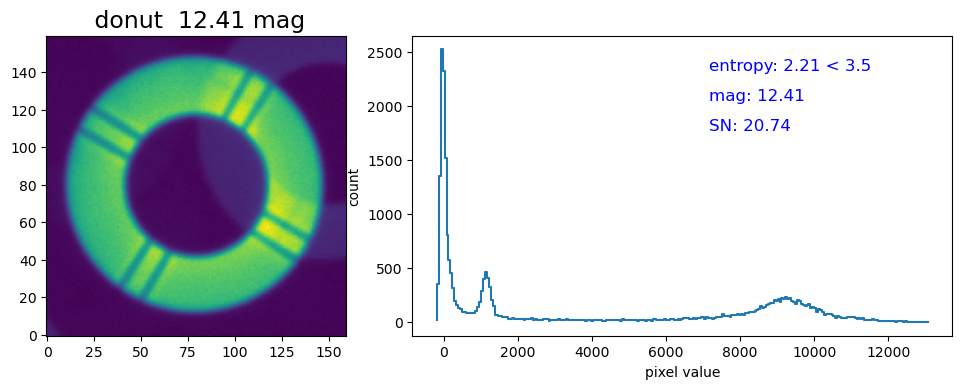

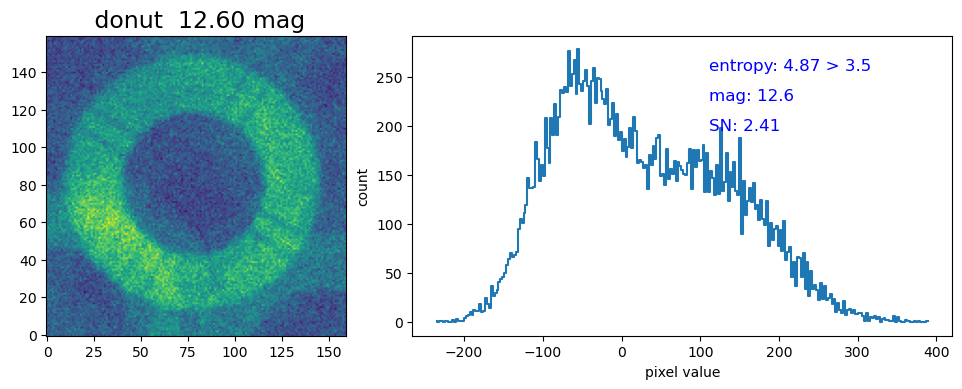

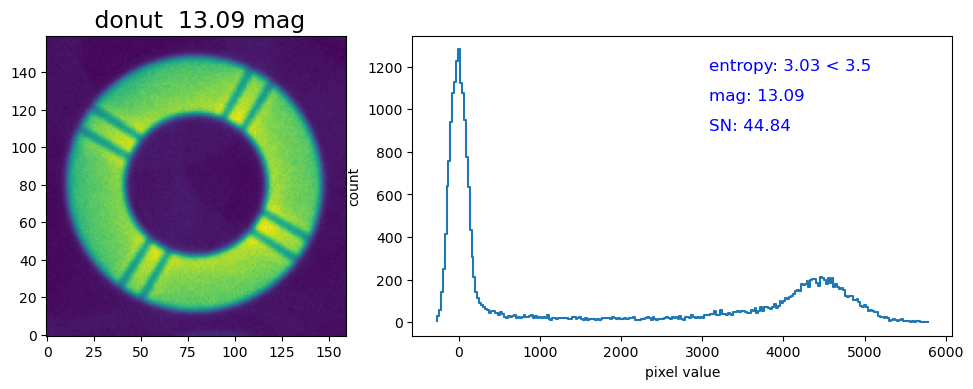

...

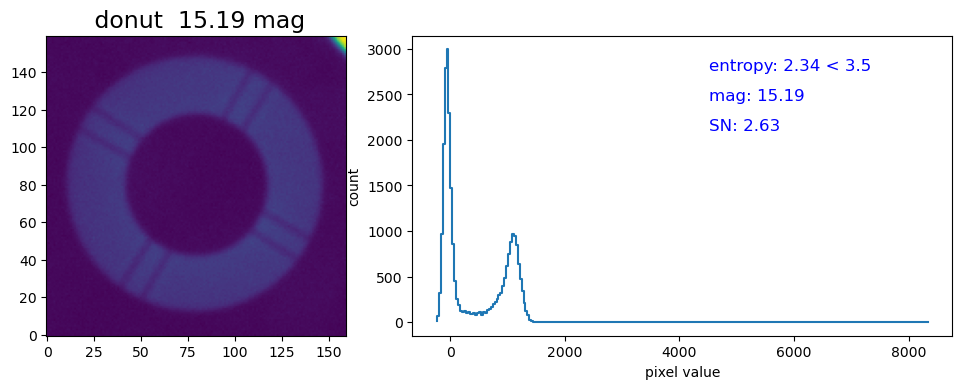

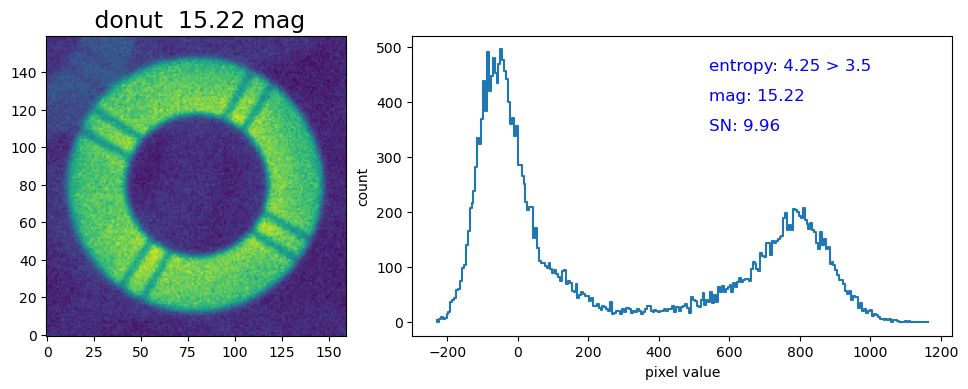

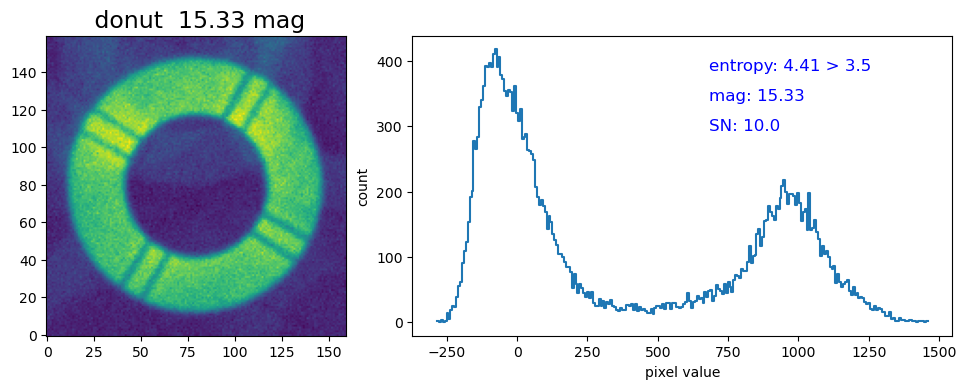

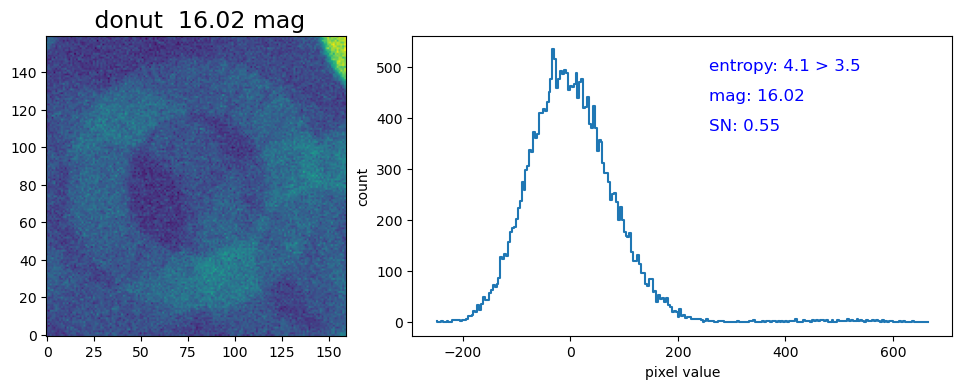

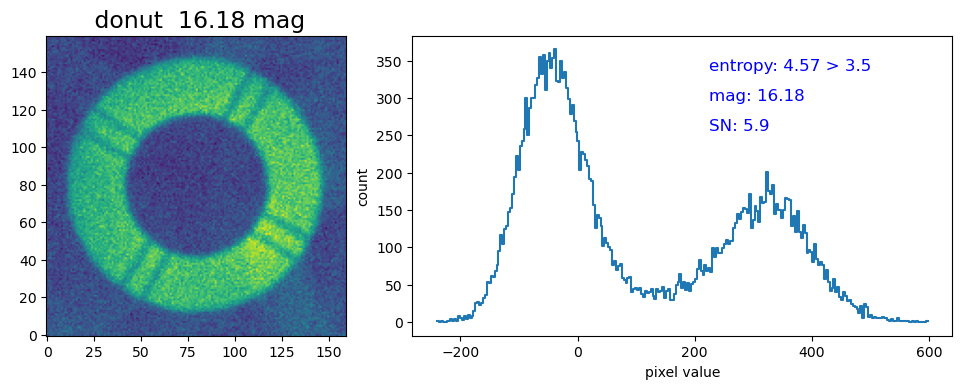

In [268]:
for iSel in range(len(donutCatalogExtra)):# 0
    mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)
    stamp = donutStampsExtra[iSel]
    sn = donutsExtraQuality['SN'][iSel]
    mag = mags[iSel]
    
    entropy, hist, edge = calculate_entropy(stamp)
    
    fig = plt.figure(figsize=(9,3))#1, figsize=(3*edge, n_donuts*edge))
    ax1 = fig.add_axes([0, 0, 0.4, 1])
    ax2 = fig.add_axes([0.44, 0, 0.6, 1])
    
    image = stamp.stamp_im.image.array
    ax1.imshow(image, origin="lower")
    ax1.set_title(f" donut  {mag:.2f} mag", fontsize=17, c="black")
    
    text_dict = {'color':'b', 'fontsize':12, 
                 'horizontalalignment':'left',
                 'verticalalignment':'center'}
    entroThres = 3.5
    sgn = '<'  if entropy<entroThres else '>'
    # position in axis2 coords 
    x1 = 0.55  ;  y1 = 0.8 ;  dy = 0.1 
    ax2.text(x1,y1+dy, f'entropy: {np.round(entropy,2)} {sgn} {entroThres}',  transform=ax2.transAxes,  **text_dict)
    ax2.text(x1,y1, f'mag: {np.round(mag,2)}',  transform=ax2.transAxes,  **text_dict)
    ax2.text(x1,y1-dy, f'SN: {np.round(sn,2)}',  transform=ax2.transAxes,  **text_dict)
    
    ax2.step(edge[:-1],hist, )
    # ax2.text(x1, y1-2*dy, f'|<mask> |={m:.2f}, \n\
    # $\sigma$(only bkgnd)={sd:.2f},  ratio={m/sd:.2f} \n\
    # $\sigma$(whole image)={sd_image:.2f}, ratio2={m/sd_image:.2f}',
    #          transform=ax2.transAxes, 
    #        **text_dict)
    
    #ax2.text(x1,y1,f'effective:{eff}',  transform=ax2.transAxes,**text_dict)
    # ax2.text(x1,y1-dy,f'SN estimate: {np.round(snbase,2)}',  transform=ax2.transAxes, **text_dict)
    #ax2.text(x1,y1-2*dy,f'SN header: {np.round(snheader,2)}', transform=ax2.transAxes, **text_dict)
    ax2.set_ylabel('count')
    ax2.set_xlabel('pixel value')


ok, submit the bps job for all sensors then... 

    cd /sdf/group/rubin/shared/scichris/DM-41957_lsstCam_sweep/

    allocateNodes.py -v -n 10 -c 32 -m 6:00:00 -q roma,milano -g 900 s3df --account rubin:commissioning

    bps submit site_bps.yaml -b  /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/gen3repo -i refcats/gaia_dr2_20200414,run_739388,LSSTCam/calib/unbounded  -o runFAM_960_962_2024_13_ext_bps_all_science  -p /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/lsstPipelineWEP_lsstfam_refactor_noISR.yaml -d "exposure.seq_num in (960,962)"

note-  there 15 failed b/c I didn't do the detector.purpose == 'SCIENCE' for this run... 

In [230]:
refs[0]

DatasetRef(DatasetType('donutStampsExtra', {band, instrument, detector, physical_filter, visit}, StampsBase), {instrument: 'LSSTCam', detector: 0, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}, run='runFAM_960_962_2024_13_ext_bps_all_science/20240426T044646Z', id=c93e17d4-a93c-4bd6-b694-d227484ba15d)

21
21
21
21
6
5
5
26
26
26
26
4
6
4
23
23
23
23
7
8
7
24
24
24
24
9
9
9


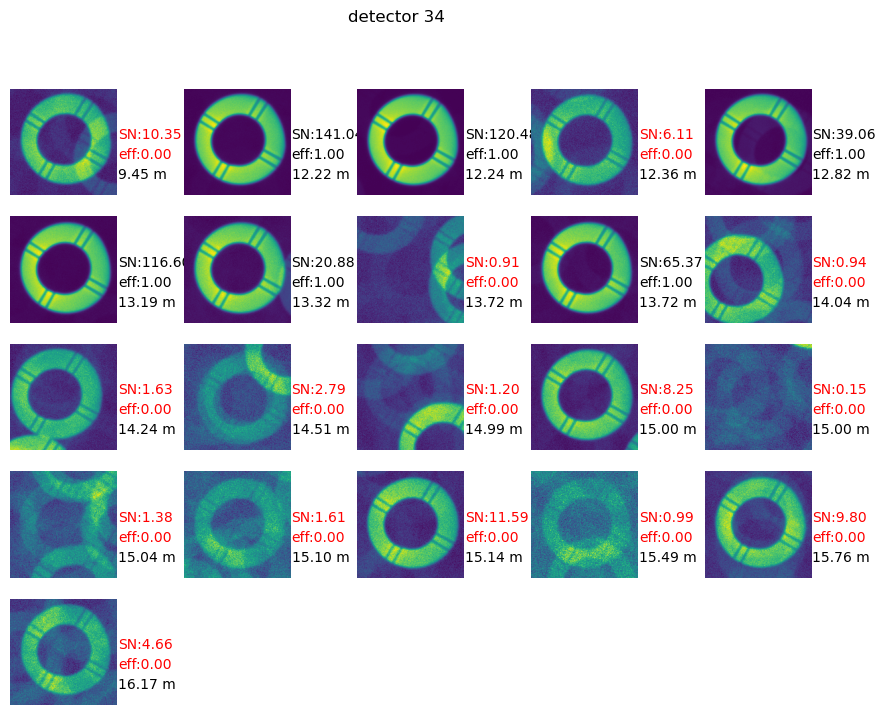

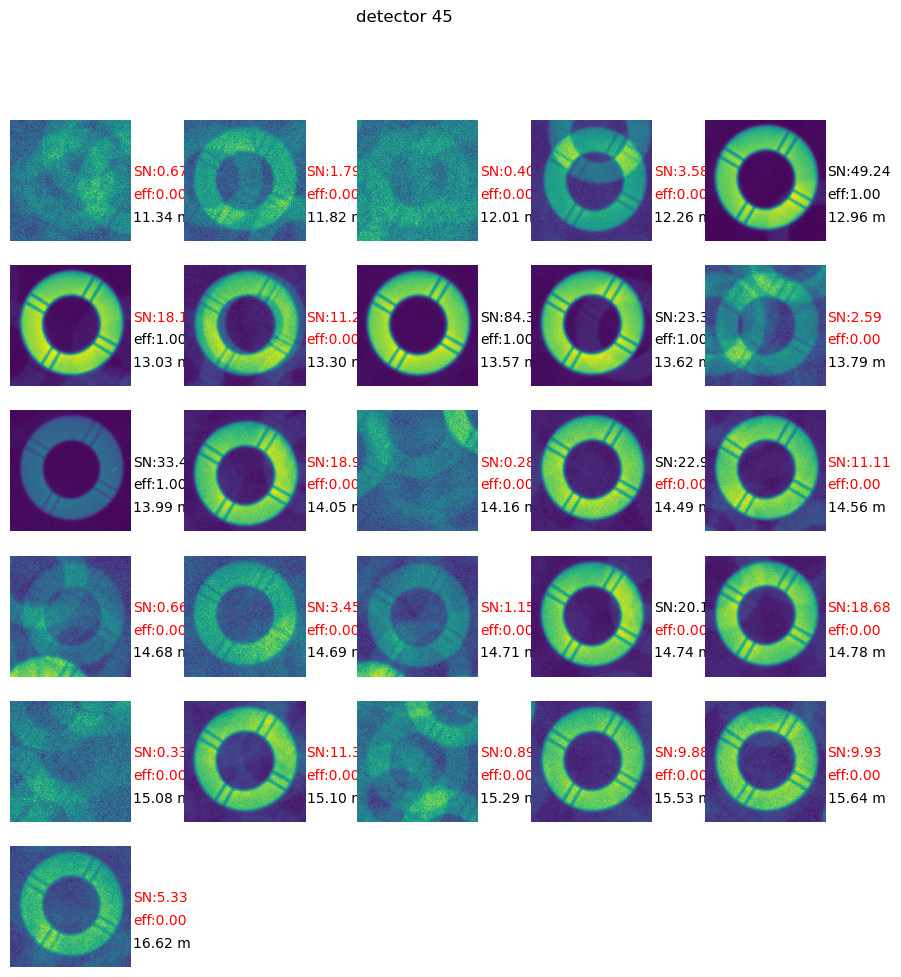

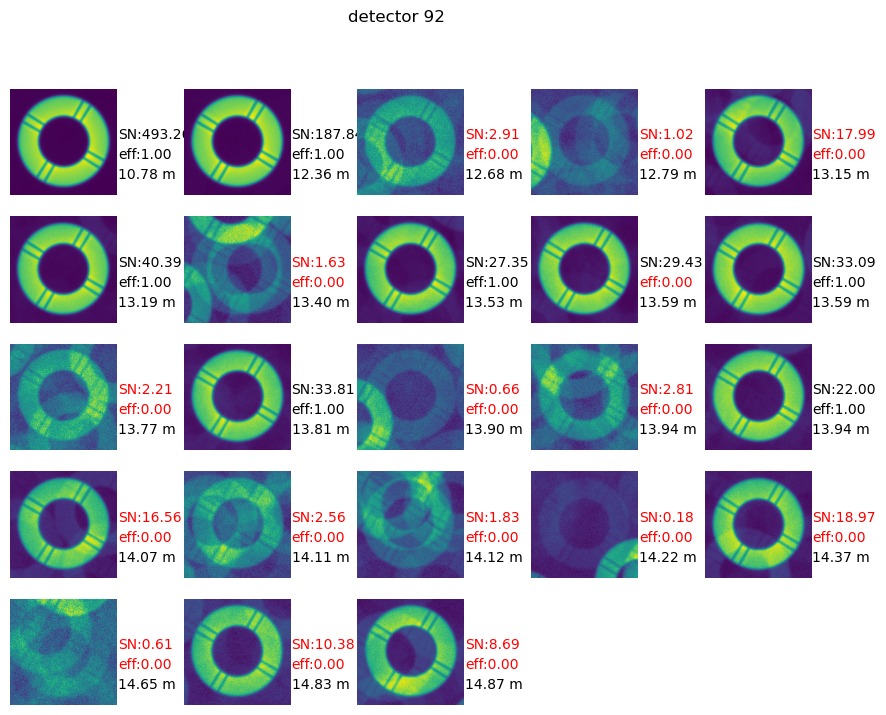

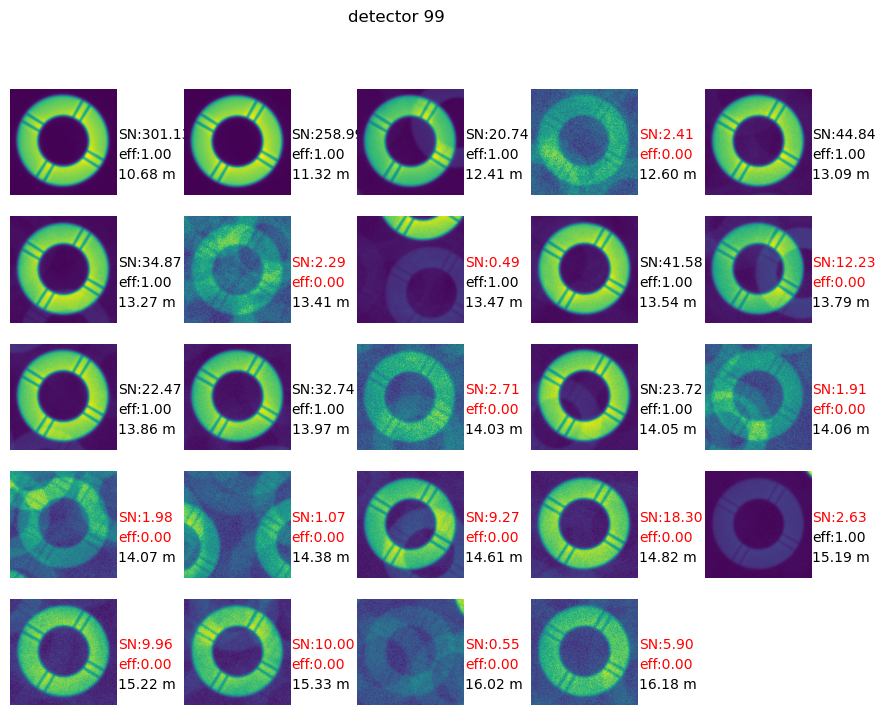

In [246]:
butler = dafButler.Butler(butlerRootPath)
registry = butler.registry

collection = 'runFAM_960_962_2024_13_ext_bps_all_science'
datasetRefs = registry.queryDatasets("donutStampsExtra", collections=[collection],
              where=f"instrument='LSSTCam'").expanded()
refs = []
for ref in datasetRefs:
    #print(ref)
    refs.append(ref)

#for i in range(10):
for detector in [34, 45, 92, 99] :  #refs[i].dataId.detector.id
    instrument = 'LSSTCam'
    exposure_extra = 5028081800962
    exposure_intra = 5028081800960
    # construct a dataId for zernikes and donut catalog:
    # switch exposure to visit
    data_id_extra = {"detector": detector, 
               "instrument": instrument, 
               "visit": exposure_extra,
               "exposure":exposure_extra
              }
    
    data_id_intra = {"detector": detector, 
               "instrument": instrument, 
               "visit": exposure_intra,
               "exposure":exposure_intra
              }
    
    donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])
    print(len(donutStampsExtra))
    
    donutStampsIntra = butler.get("donutStampsIntra", dataId=data_id_extra, collections=[collection])
    print(len(donutStampsIntra))
    
    donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
    print(len(donutCatalogExtra))
    
    donutCatalogIntra = butler.get("donutCatalog", dataId=data_id_intra, collections=[collection])
    print(len(donutCatalogIntra))
    
    donutsExtraQuality = butler.get("donutsExtraQuality", dataId=data_id_extra, collections=[collection])
    donutsIntraQuality = butler.get("donutsIntraQuality", dataId=data_id_extra, collections=[collection])
    
    print(len(donutsExtraQuality[donutsExtraQuality['FINAL_SELECT']==True]))
    print(len(donutsIntraQuality[donutsIntraQuality['FINAL_SELECT']==True]))
    
    zkRaw = butler.get("zernikeEstimateRaw", dataId=data_id_extra, collections=[collection])
    print(len(zkRaw))
    
    
    
    # plot extra-focal 
    if len(donutCatalogExtra)<26:
        fig,axs = plt.subplots(5,5, figsize=(11,8))
    else:
        fig,axs = plt.subplots(6,5, figsize=(11,11))
    ax = np.ravel(axs)
    
    mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)
    
    n = len(donutStampsExtra)
    for i in range(len(donutStampsExtra)):
        ax[i].imshow(donutStampsExtra[i].stamp_im.image.array, origin='lower')
        color = 'black' 
        sn = donutsExtraQuality['SN'][i]
        if sn < 20:
            color='red'
        ax[i].text(162,85,f"SN:{sn:.2f}", color=color)
    
        en = donutsExtraQuality['EFFECTIVE_SELECT'][i]
        color = 'black' 
        if not en:
            color='red'
        ax[i].text(162,55,f"eff:{en:.2f}", color=color)
        ax[i].text(162,25, f"{mags[i]:.2f} m")
        ax[i].axis('off')
    if n < len(ax):  
        for j in range(n, len(ax)):
            ax[j].axis('off')
    fig.subplots_adjust(hspace=0.2)
    fig.subplots_adjust(wspace=0.1)
    fig.suptitle(f'detector {detector}')


# Run the same calculation but use the variance plane, i.e. do the ISR... 

First, run ISR only (with variance) and store it as run_739388_var  . Edit the `lsstPipelineISR.yaml` by setting `doVariance: True`, saving it as `lsstPipelineISRvar.yaml` 


    cd /sdf/group/rubin/shared/scichris/DM-41957_lsstCam_sweep/

    allocateNodes.py -v -n 10 -c 32 -m 6:00:00 -q roma,milano -g 900 s3df --account rubin:commissioning

    bps submit site_bps.yaml -b  /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/gen3repo -i LSSTCam/raw/all,LSSTCam/calib/unbounded  -o run_739388_var  -p /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/lsstPipelineISRvar.yaml -d "exposure.seq_num in (960,961,962)" 

I check 

bps report --id 8641331.0

Make sure to do the proper setup:

    >> lsst
    >> aos 




Then I submit the new calculation of cutouts for two detectors as a quick test: 

    allocateNodes.py -v -n 10 -c 32 -m 6:00:00 -q roma,milano -g 900 s3df --account rubin:commissioning

    bps submit site_bps.yaml -b  /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/gen3repo -i refcats/gaia_dr2_20200414,run_739388_var,LSSTCam/calib/unbounded  -o runFAM_960_962_2024_17_bps_93-94_var  -p /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/lsstPipelineWEP_lsstfam_refactor_noISR.yaml -d "exposure.seq_num in (960,962) and detector in (93,94)"

but it immediately fails : why ? 

    bps report --id 8641925.0 



# Run CutOutDonutsScienceSensorTask  in the notebook 

Try running it in the notebook:

In [1]:
import lsst.daf.butler as dafButler
import os
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/'
butlerRootPath = os.path.join(path_cwd, 'gen3repo')
butler = dafButler.Butler(butlerRootPath)

inputRun = 'run_739388_var'
detector = 94
instrument = 'LSSTCam'
exposure_extra = 5028081800962
exposure_intra = 5028081800960
# construct a dataId for zernikes and donut catalog:
# switch exposure to visit
data_id_extra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_extra,
           "exposure":exposure_extra
          }

data_id_intra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_intra,
           "exposure":exposure_intra
          }


exposure_intra = butler.get("postISRCCD", dataId=data_id_intra, collections=[inputRun])
exposure_extra = butler.get("postISRCCD", dataId=data_id_extra, collections=[inputRun])



In [275]:
butler.registry.queryCollections()

['refcats/gaia_dr2_20200414',
 'LSSTCam/calib',
 'LSSTCam/calib/unbounded',
 'LSSTCam/calib/curated/19700101T000000Z',
 'LSSTCam/raw/all',
 'run1',
 'runFAM_test',
 'runFAM',
 'runFAM1',
 'runFAM_det160-161',
 'runFAM_det160-161_1',
 'runFAM_det160-161_2',
 'runFAM_det160-161_3',
 'runFAM_det160-161_4',
 'runFAM_det160-161_37',
 'runFAM_det160-161_46',
 'runFAM_det160-161_36',
 'runFAM_det160-161_30',
 'runFAM_det160-161_2023_47_ext',
 'runFAM_det160-161_2023_47_ext_1',
 'runFAM_det93-94_2023_47_ext_1',
 'runFAM_det93-94_2023_47_ext_lim_13-17',
 'runFAM_940-942',
 'run_739789',
 'run_739388',
 'runFAM_960_962_det93-94_2023_47_ext_lim_11-15',
 'aaa_bps_test2/20240110T004504Z',
 'runFAM_960_962_all_det_2023_47_ext_lim_11-15_bps/20240110T060752Z',
 'runFAM_960_962_all_det_2023_47_ext_lim_11-15_bps_science/20240110T062107Z',
 'runFAM_960_962_all_det_2024_02_ext_lim_12-15_bps_science/20240124T223708Z',
 'runFAM_961_all_det_2024_02_ext_lim_12-15_bps_wavefront/20240124T224434Z',
 'runFAM_961_

22
22


In [2]:

from lsst.ts.wep.task.cutOutDonutsScienceSensorTask import (
CutOutDonutsScienceSensorTask,CutOutDonutsScienceSensorTaskConfig )


collection = 'runFAM_960_962_2024_17_bps_93-94_var'
#collection='runFAM_det160-161_1'
donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
print(len(donutCatalogExtra))


donutCatalogIntra = butler.get("donutCatalog", dataId=data_id_intra, collections=[collection])
print(len(donutCatalogIntra))
                      


camera  = butler.get('camera',  dataId=data_id_extra, collections=[collection])

cutoutTaskConfig = CutOutDonutsScienceSensorTaskConfig()


cutoutTask = CutOutDonutsScienceSensorTask(config=cutoutTaskConfig)


cutouts = cutoutTask.run([exposure_extra, exposure_intra],
                         [donutCatalogExtra,donutCatalogIntra],
                         camera)
   

23
23


In [3]:
list(cutouts.donutStampsExtra.metadata)

['RA_DEG',
 'DEC_DEG',
 'DET_NAME',
 'CAM_NAME',
 'DFC_TYPE',
 'DFC_DIST',
 'CENT_X',
 'CENT_Y',
 'BLEND_CX',
 'BLEND_CY',
 'X0',
 'Y0',
 'SN',
 'SIGNAL',
 'NOISE',
 'NOISE_VAR',
 'SN_VAR',
 'STDEV_BKGD',
 'SQRT_VAR_BGKD',
 'EFFECTIVE',
 'ENTROPY']

ok, everything is there. Plot the calculated values: 

In [8]:
exposure_extra.getDetector().getName()

'R22_S11'

In [10]:
exposure_extra.getDetector().getId()

94

Text(0.5, 0.98, 'R22_S11 (det 94)')

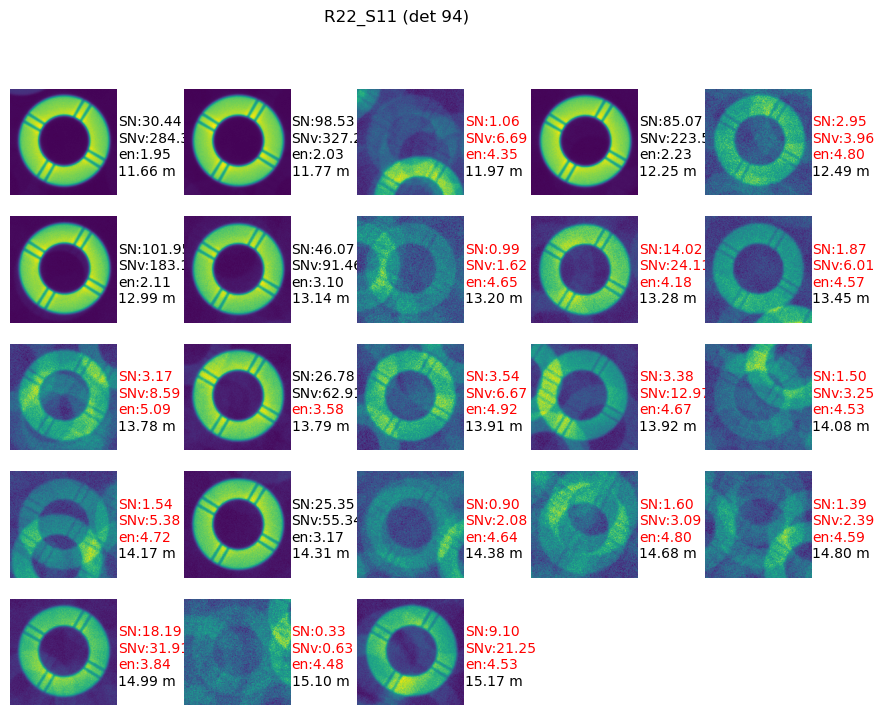

In [12]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import astropy.units as u

donutStampsExtra = cutouts.donutStampsExtra

effective = donutStampsExtra.metadata.getArray('EFFECTIVE')
sn_arr = donutStampsExtra.metadata.getArray('SN')
snvar_arr = donutStampsExtra.metadata.getArray('SN_VAR')
entropy = donutStampsExtra.metadata.getArray('ENTROPY')

fig,axs = plt.subplots(5,5, figsize=(11,8))
ax = np.ravel(axs)

mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)

ytop = 105
dy = 25
n = len(donutStampsExtra)
for i in range(len(donutStampsExtra)):
    ax[i].imshow(donutStampsExtra[i].stamp_im.image.array, origin='lower')
    color = 'black' 
    sn = sn_arr[i]
    if sn < 20:
        color='red'
    ax[i].text(162,ytop,f"SN:{sn:.2f}", color=color)
    ax[i].text(162,ytop-dy,f"SNv:{snvar_arr[i]:.2f}", color=color)


    en = entropy[i] < 3.5
    color = 'black' 
    if not en:
        color='red'
    ax[i].text(162,ytop-2*dy,f"en:{entropy[i]:.2f}", color=color)
    ax[i].text(162,ytop-3*dy, f"{mags[i]:.2f} m")
    ax[i].axis('off')
if n < len(ax):  
    for j in range(n, len(ax)):
        ax[j].axis('off')
fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0.1)
fig.suptitle( f'{exposure_extra.getDetector().getName()} (det {exposure_extra.getDetector().getId()})')

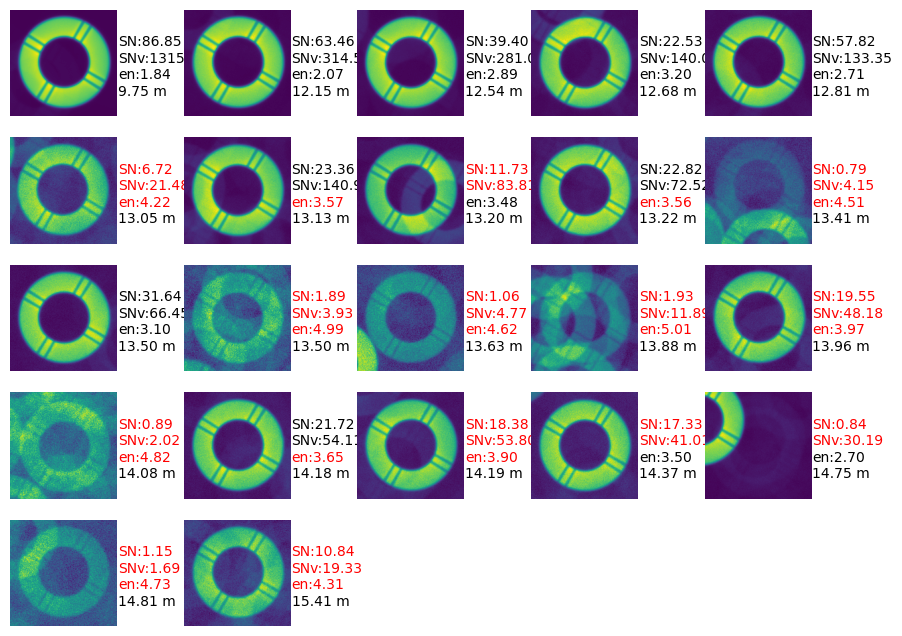

In [10]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import astropy.units as u

donutStampsExtra = cutouts.donutStampsExtra

effective = donutStampsExtra.metadata.getArray('EFFECTIVE')
sn_arr = donutStampsExtra.metadata.getArray('SN')
snvar_arr = donutStampsExtra.metadata.getArray('SN_VAR')
entropy = donutStampsExtra.metadata.getArray('ENTROPY')

fig,axs = plt.subplots(5,5, figsize=(11,8))
ax = np.ravel(axs)

mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)

ytop = 105
dy = 25
n = len(donutStampsExtra)
for i in range(len(donutStampsExtra)):
    ax[i].imshow(donutStampsExtra[i].stamp_im.image.array, origin='lower')
    color = 'black' 
    sn = sn_arr[i]
    if sn < 20:
        color='red'
    ax[i].text(162,ytop,f"SN:{sn:.2f}", color=color)
    ax[i].text(162,ytop-dy,f"SNv:{snvar_arr[i]:.2f}", color=color)


    en = entropy[i] < 3.5
    color = 'black' 
    if not en:
        color='red'
    ax[i].text(162,ytop-2*dy,f"en:{entropy[i]:.2f}", color=color)
    ax[i].text(162,ytop-3*dy, f"{mags[i]:.2f} m")
    ax[i].axis('off')
if n < len(ax):  
    for j in range(n, len(ax)):
        ax[j].axis('off')
fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0.1)
fig.suptitle*

Next: 

* run for all detectors
  
* plot the SN vs SN_var,  as well as the main difference : mean_stdev_background  vs mean_sqrt_variance ... 

* with the new SN measure,  plot the SN_var vs entropy   and SN_var vs magnitude... nm

# Run new donutCutouts and calcZernikes (with configurable thresholds) via bps 
to get more donut stats  (esp. re magnitude vs calculated entropy vs SN vs SN_VAR) 

    allocateNodes.py -v -n 10 -c 32 -m 6:00:00 -q roma,milano -g 900 s3df --account rubin:commissioning
    
    bps submit site_bps.yaml -b  /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/gen3repo -i refcats/gaia_dr2_20200414,run_739388_var,LSSTCam/calib/unbounded  -o runFAM_960_962_2024_17_bps_all_science_var  -p /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/lsstPipelineWEP_lsstfam_refactor_noISR.yaml -d "exposure.seq_num in (960,962) and  detector.purpose = 'SCIENCE'"

     bps report --id 8652032.0

     

In [3]:
import lsst.daf.butler as dafButler
import os
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/'
butlerRootPath = os.path.join(path_cwd, 'gen3repo')
butler = dafButler.Butler(butlerRootPath)
collection = 'runFAM_960_962_2024_17_bps_all_science_var'
registry = butler.registry
datasetRefs = registry.queryDatasets("donutStampsExtra",collections=[collection],
              where=f"instrument='LSSTCam'").expanded()
refs = []
for ref in datasetRefs:
    #print(ref)
    refs.append(ref)



In [16]:
collection

'runFAM_960_962_2024_17_bps_93-94_var'

In [23]:
#refs

In [4]:
detector = 4
instrument = 'LSSTCam'
exposure_extra = 5028081800962
exposure_intra = 5028081800960
# construct a dataId for zernikes and donut catalog:
# switch exposure to visit
data_id_extra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_extra,
           "exposure":exposure_extra
          }

data_id_intra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_intra,
           "exposure":exposure_intra
          }


exposure_intra = butler.get("postISRCCD", dataId=data_id_intra, collections=[collection])
exposure_extra = butler.get("postISRCCD", dataId=data_id_extra, collections=[collection])



In [5]:
exposure_extra

In [27]:
#zscale.get_plt.imshow(exposure_intra.image.array, origin='lower')

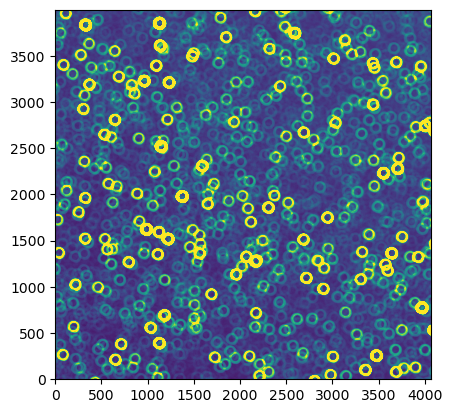

In [28]:
import matplotlib.pyplot as plt 
from astropy.visualization import ZScaleInterval
zscale = ZScaleInterval()

d = exposure_intra.image.array
vmin,vmax = zscale.get_limits(d)

plt.imshow(d, vmin=vmin, vmax=vmax,  origin='lower', )


Show that now the donut stamps have all the info that would allow to quickly make the plot of eg. SN vs SN_var vs entropy ... 

In [37]:
donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])
print(len(donutStampsExtra))

# donutStampsIntra = butler.get("donutStampsIntra", dataId=data_id_intra, collections=[collection])
# print(len(donutStampsIntra))



26


In [6]:
donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
print(len(donutCatalogExtra))

26


In [31]:
list(donutStampsExtra.metadata)

['SIMPLE',
 'BITPIX',
 'NAXIS',
 'EXTEND',
 'COMMENT',
 'RA_DEG',
 'DEC_DEG',
 'DET_NAME',
 'CAM_NAME',
 'DFC_TYPE',
 'DFC_DIST',
 'CENT_X',
 'CENT_Y',
 'BLEND_CX',
 'BLEND_CY',
 'X0',
 'Y0',
 'SN',
 'SIGNAL',
 'NOISE',
 'NOISE_VAR',
 'SN_VAR',
 'STDEV_BKGD',
 'SQRT_VAR_BGKD',
 'EFFECTIVE',
 'ENTROPY',
 'BANDPASS',
 'HAS_MASK',
 'HAS_VARIANCE',
 'HAS_ARCHIVE',
 'N_STAMPS',
 'STAMPCLS',
 'VERSION',
 'ARCHIVE_IDS']

In [38]:

mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)

In [34]:
donutStamps = donutStampsExtra
SN = donutStamps.metadata.getArray('SN')
SN_VAR = donutStamps.metadata.getArray('SN_VAR')
NOISE= donutStamps.metadata.getArray('NOISE')
NOISE_VAR= donutStamps.metadata.getArray('NOISE_VAR')
STDEV_BKGD= donutStamps.metadata.getArray('STDEV_BKGD')
SQRT_VAR_BGKD= donutStamps.metadata.getArray('SQRT_VAR_BGKD')
ENTROPY= donutStamps.metadata.getArray('ENTROPY')

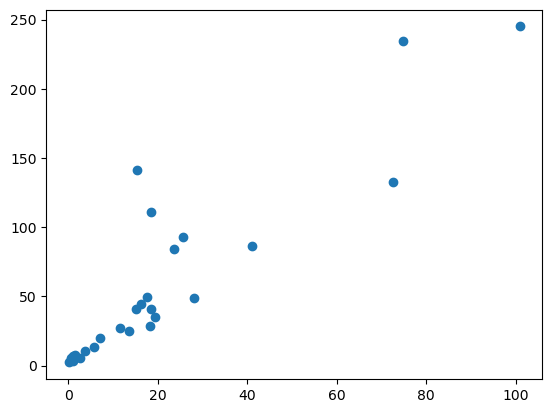

In [41]:
plt.scatter(SN, SN_VAR)#plt.scatter(mags, SN)

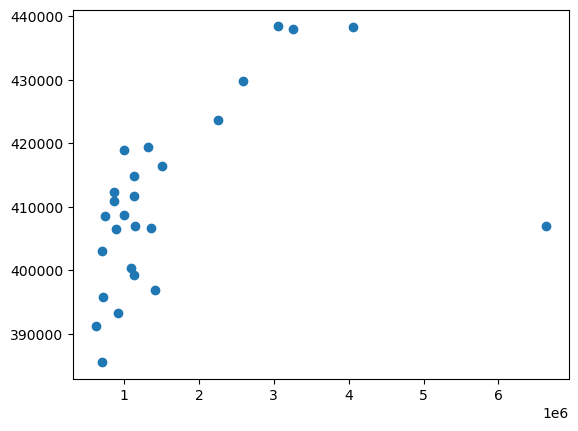

In [42]:
plt.scatter(NOISE, NOISE_VAR)

In [38]:
import astropy.units as u
# refs were queried on the extra-focal dataId,  so
# only the extra-focal ones are here, i.e. seqNum 902
sn_arr = []
snvar_arr = []
noise_arr=[]
noisevar_arr=[]
stdev_bkgd_arr=[]
sqrt_var_bkgd_arr = []
entropy_arr = []
mags_arr = []

# detector = 65
# instrument='LSSTCam'
# exposure_extra = 5028081800962
# data_id_extra = {"detector": detector, 
#            "instrument": instrument, 
#            "visit": exposure_extra,
#            "exposure":exposure_extra
#           }
for ref in refs:
    data_id_extra = ref.dataId
    print(data_id_extra)
    donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])
    if len(donutStampsExtra)>0:
        donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
        mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)
        mags_arr.extend(mags)
        
        #print(ref.dataId)
        donutStamps = donutStampsExtra
        SN = donutStamps.metadata.getArray('SN')
        SN_VAR = donutStamps.metadata.getArray('SN_VAR')
        NOISE= donutStamps.metadata.getArray('NOISE')
        NOISE_VAR= donutStamps.metadata.getArray('NOISE_VAR')
        STDEV_BKGD= donutStamps.metadata.getArray('STDEV_BKGD')
        SQRT_VAR_BGKD= donutStamps.metadata.getArray('SQRT_VAR_BGKD')
        ENTROPY= donutStamps.metadata.getArray('ENTROPY')
        
        sn_arr.extend(SN)
        snvar_arr.extend(SN_VAR)
        noise_arr.extend(NOISE)
        noisevar_arr.extend(NOISE_VAR)
        stdev_bkgd_arr.extend(STDEV_BKGD)
        sqrt_var_bkgd_arr.extend(SQRT_VAR_BGKD)
        entropy_arr.extend(ENTROPY)


{instrument: 'LSSTCam', detector: 0, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 1, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 2, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 3, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 4, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 5, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 6, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 7, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 8, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 9, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 10, visit: 50280

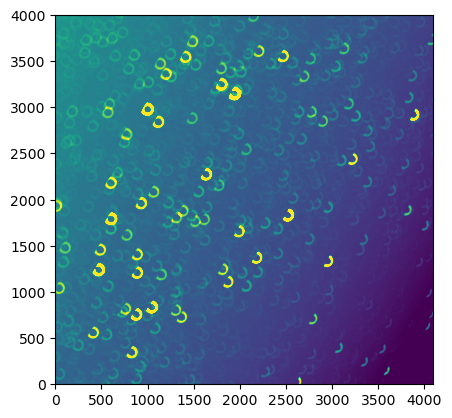

In [34]:
from astropy.visualization import ZScaleInterval
zscale = ZScaleInterval()
isrCollection = 'run_739388_var'
data_id_extra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_extra,
           "exposure":exposure_extra
          }
exposure_extra = butler.get("postISRCCD", dataId=data_id_extra, collections=[isrCollection])
d = exposure_extra.image.array
vmin,vmax = zscale.get_limits(d)

plt.imshow(d, vmin=vmin, vmax=vmax,  origin='lower', )

ok, this detector is so heavily vignetted that no donuts pass the distance from the center criterion: 

In [37]:
len(donutStampsExtra)

0

Text(0, 0.5, 'Shannon Entropy')

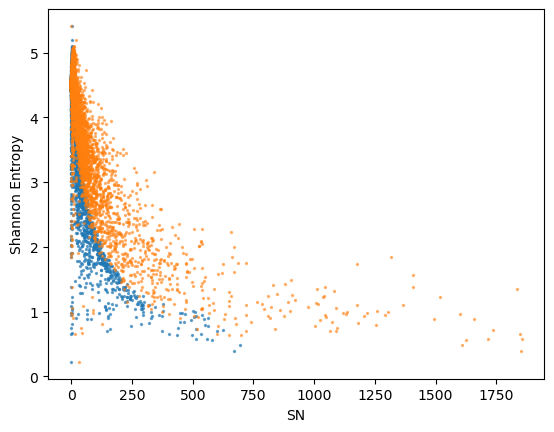

In [41]:
import matplotlib.pyplot as plt
plt.scatter(sn_arr, entropy_arr, s=2,  alpha=0.6, label='stdev-based SN')
plt.scatter(snvar_arr, entropy_arr, s=2, alpha=0.5, label='variance-based SN')
plt.xlabel('SN')
plt.ylabel('Shannon Entropy')


Text(0, 0.5, 'Noise measure per pixel')

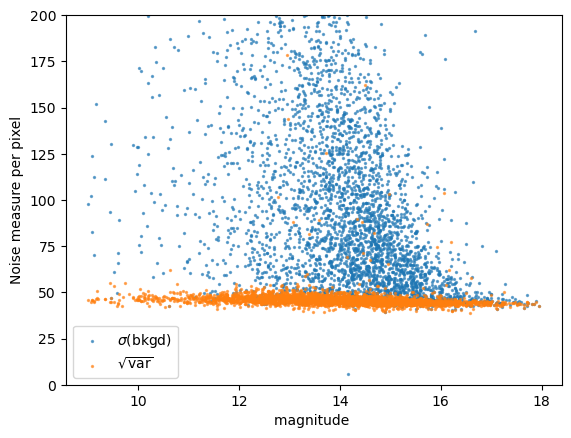

In [42]:
plt.scatter(mags_arr, stdev_bkgd_arr,s=2,  alpha=0.6,label=r'$\sigma(\mathrm{bkgd})$')
plt.scatter(mags_arr, sqrt_var_bkgd_arr, s=2,  alpha=0.6,label=r'$\sqrt{\mathrm{var}}$')
plt.ylim(0,200)
plt.legend()
plt.xlabel('magnitude ' )
plt.ylabel('Noise measure per pixel')

Text(0, 0.5, 'Shannon Entropy')

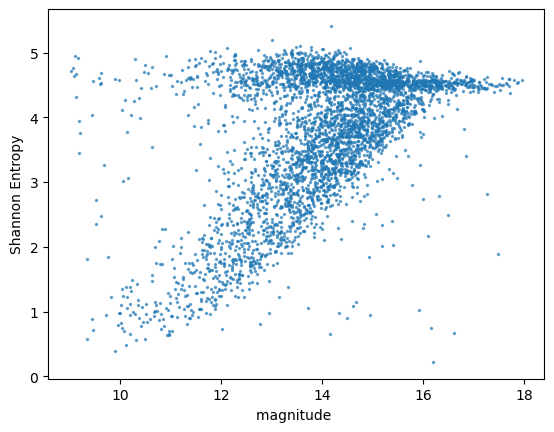

In [43]:
plt.scatter(mags_arr, entropy_arr,s=2,  alpha=0.6,)
#plt.scatter(mags_arr, sqrt_var_bkgd_arr, label=r'$\sqrt{\mathrm{var}}$')
#plt.ylim(0,200)
#plt.legend()
plt.xlabel('magnitude ' )
plt.ylabel('Shannon Entropy')

ok, show donut arrays: 

In [45]:
donutStampsExtra.getDetectorNames()

['R43_S22', 'R43_S22']

In [49]:
ref.dataId

{instrument: 'LSSTCam', detector: 56, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}

Text(0.5, 0.98, 'R13_S02')

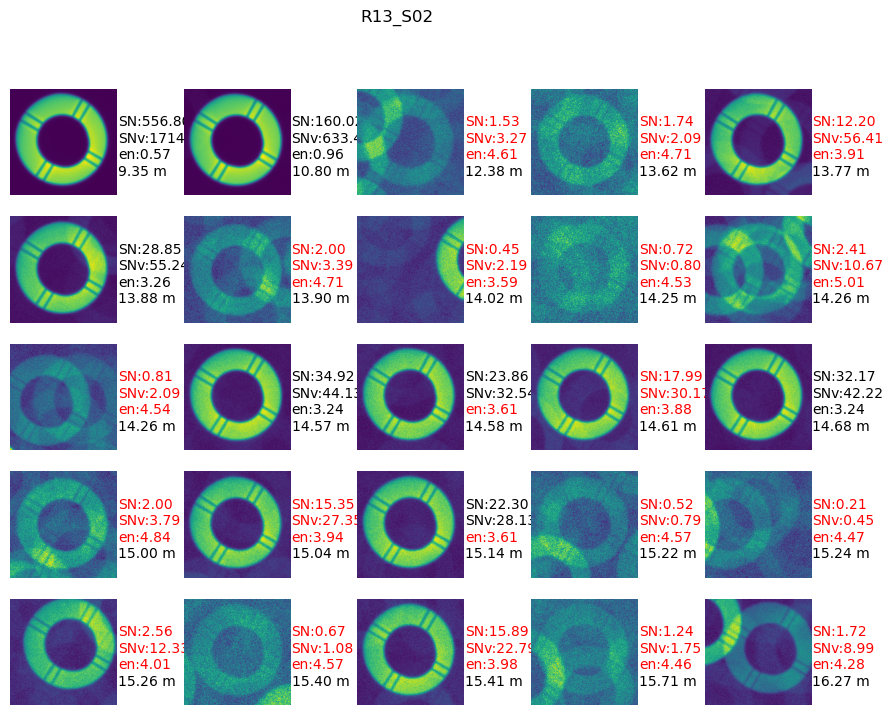

In [51]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import astropy.units as u

ref = refs[56]
data_id_extra = ref.dataId
donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])
if len(donutStampsExtra)>0:
    donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
    mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)
#mags_arr.extend(mags)


effective = donutStampsExtra.metadata.getArray('EFFECTIVE')
sn_arr = donutStampsExtra.metadata.getArray('SN')
snvar_arr = donutStampsExtra.metadata.getArray('SN_VAR')
entropy = donutStampsExtra.metadata.getArray('ENTROPY')

fig,axs = plt.subplots(5,5, figsize=(11,8))
ax = np.ravel(axs)

mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)

ytop = 105
dy = 25
n = len(donutStampsExtra)
for i in range(len(donutStampsExtra)):
    ax[i].imshow(donutStampsExtra[i].stamp_im.image.array, origin='lower')
    color = 'black' 
    sn = sn_arr[i]
    if sn < 20:
        color='red'
    ax[i].text(162,ytop,f"SN:{sn:.2f}", color=color)
    ax[i].text(162,ytop-dy,f"SNv:{snvar_arr[i]:.2f}", color=color)


    en = entropy[i] < 3.5
    color = 'black' 
    if not en:
        color='red'
    ax[i].text(162,ytop-2*dy,f"en:{entropy[i]:.2f}", color=color)
    ax[i].text(162,ytop-3*dy, f"{mags[i]:.2f} m")
    ax[i].axis('off')
if n < len(ax):  
    for j in range(n, len(ax)):
        ax[j].axis('off')
fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0.1)
fig.suptitle(donutStampsExtra.getDetectorNames()[0])

## 5/8/24 : Do the same, but with a better SN definition


Following Josh's suggestion, use 

$SNvd =  \frac{\sum\mathrm{image[donutMask]}} {\sqrt{ \sum\mathrm{variance[donutMask]} }} $

    cd /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/
    lsst
    aos
    
    
    allocateNodes.py -v -n 10 -c 32 -m 6:00:00 -q roma,milano -g 900 s3df --account rubin:commissioning
    
    bps submit site_bps.yaml -b  /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/gen3repo -i refcats/gaia_dr2_20200414,run_739388_var,LSSTCam/calib/unbounded  -o runFAM_960_962_d_2024_05_06_bps_all_science_var_SN  -p /sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/lsstPipelineWEP_lsstfam_refactor_noISR.yaml -d "exposure.seq_num in (960,962) and  detector.purpose = 'SCIENCE'"

    

In [4]:
import lsst.daf.butler as dafButler
import os
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/'
butlerRootPath = os.path.join(path_cwd, 'gen3repo')
butler = dafButler.Butler(butlerRootPath)
collection = 'runFAM_960_962_d_2024_05_06_bps_all_science_var_SN'
registry = butler.registry
datasetRefs = registry.queryDatasets("donutStampsExtra",collections=[collection],
              where=f"instrument='LSSTCam'").expanded()
refs = []
for ref in datasetRefs:
    #print(ref)
    refs.append(ref)

detector.RecordClass(instrument='LSSTCam', id=0, full_name='R01_S00', name_in_raft='S00', raft='R01', purpose='SCIENCE')

Get just one set of donut stamps to get metadata:

In [5]:
data_id_extra = ref.dataId
donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])
#metadic = {}
metakeys = list(donutStampsExtra.metadata)
# for metakey in list(donutStampsExtra.metadata):
#     metadic[metakey] = donutStampsExtra.metadata.getArray(metakey)


In [6]:
import numpy as np
np.ravel(list(metakeys))

array(['SIMPLE', 'BITPIX', 'NAXIS', 'EXTEND', 'COMMENT', 'RA_DEG',
       'DEC_DEG', 'DET_NAME', 'CAM_NAME', 'DFC_TYPE', 'DFC_DIST',
       'CENT_X', 'CENT_Y', 'BLEND_CX', 'BLEND_CY', 'X0', 'Y0', 'SN',
       'SIGNAL', 'NOISE', 'NOISE_VAR', 'SN_VAR', 'STDEV_BKGD',
       'SQRT_VAR_BGKD', 'VAR_BGKD', 'VAR_SUM', 'NPX_MASK', 'SN_SUM',
       'SN_VB', 'SN_VD', 'MEAN_IMAGE_BACKGROUND', 'SIGNAL_SUM',
       'EFFECTIVE', 'ENTROPY', 'PEAK_HEIGHT', 'BANDPASS', 'HAS_MASK',
       'HAS_VARIANCE', 'HAS_ARCHIVE', 'N_STAMPS', 'STAMPCLS', 'VERSION',
       'ARCHIVE_IDS'], dtype='<U21')

In [7]:
import astropy.units as u
# refs were queried on the extra-focal dataId,  so
# only the extra-focal ones are here, i.e. seqNum 902

# initialize storage dict 
summary = {}
for key in metakeys:
    summary[key] = []   
summary['mag'] = []

# go over all detectors 
for ref in refs:
    data_id_extra = ref.dataId
    print(data_id_extra)
    donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])
    if len(donutStampsExtra)>0:
        donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
        mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)
        summary['mag'].extend(mags)
        
        for key in metakeys:
            summary[key].extend(donutStampsExtra.metadata.getArray(key))
       

{instrument: 'LSSTCam', detector: 0, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 1, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 2, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 3, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 4, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 5, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 6, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 7, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 8, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 9, visit: 5028081800962, band: 'z', physical_filter: 'z_20'}
{instrument: 'LSSTCam', detector: 10, visit: 50280

In [41]:
summary.keys()

dict_keys(['SIMPLE', 'BITPIX', 'NAXIS', 'EXTEND', 'COMMENT', 'RA_DEG', 'DEC_DEG', 'DET_NAME', 'CAM_NAME', 'DFC_TYPE', 'DFC_DIST', 'CENT_X', 'CENT_Y', 'BLEND_CX', 'BLEND_CY', 'X0', 'Y0', 'SN', 'SIGNAL', 'NOISE', 'NOISE_VAR', 'SN_VAR', 'STDEV_BKGD', 'SQRT_VAR_BGKD', 'VAR_BGKD', 'VAR_SUM', 'NPX_MASK', 'SN_SUM', 'SN_VB', 'SN_VD', 'MEAN_IMAGE_BACKGROUND', 'SIGNAL_SUM', 'EFFECTIVE', 'ENTROPY', 'PEAK_HEIGHT', 'BANDPASS', 'HAS_MASK', 'HAS_VARIANCE', 'HAS_ARCHIVE', 'N_STAMPS', 'STAMPCLS', 'VERSION', 'ARCHIVE_IDS', 'mag'])

this ids which donut in a detector : `summary['ARCHIVE_IDS'][:100]`

this tells us  which detector : `summary['DET_NAME'][:100]` 

In [ ]:
donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])

In [1]:
plt.scatter(summary['mag'], np.asarray(summary['SN_SUM'])- np.asarray(summary['SN_VD']))
plt.ylabel('SN_SUM - SN_VD') 

NameError: name 'plt' is not defined

this just reflects that N_px * mean_signal is the same as sum_signal  for the donut, as SN_SUM  uses the sum of pixels in the donut, and SN_VD uses the number of pixels in the donut mask * mean donut signal.  

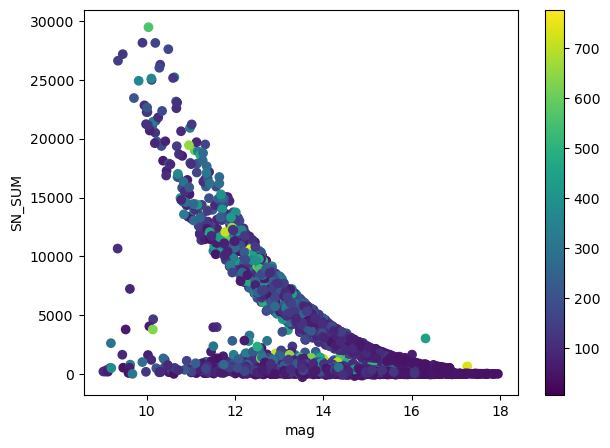

In [87]:
import matplotlib.pyplot as plt
fig,ax = plt.subplots(1,1,figsize=(7,5))
m = np.asarray(summary['STDEV_BKGD'])<800
image = ax.scatter(np.asarray(summary['mag'])[m], np.asarray(summary['SN_SUM'])[m],
                   c=np.asarray(summary['STDEV_BKGD'])[m])
ax.set_xlabel('mag')
ax.set_ylabel('SN_SUM')
plt.colorbar(image)

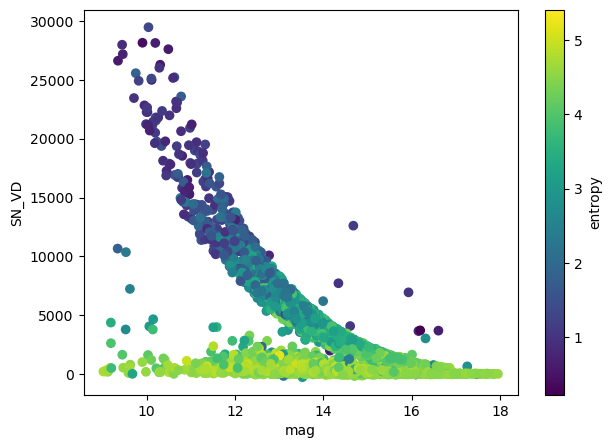

In [105]:
import matplotlib.pyplot as plt
fig,ax = plt.subplots(1,1,figsize=(7,5))
image = ax.scatter(summary['mag'], summary['SN_VD'],c=summary['ENTROPY'])
ax.set_xlabel('mag')
ax.set_ylabel('SN_VD')
plt.colorbar(image, label='entropy')

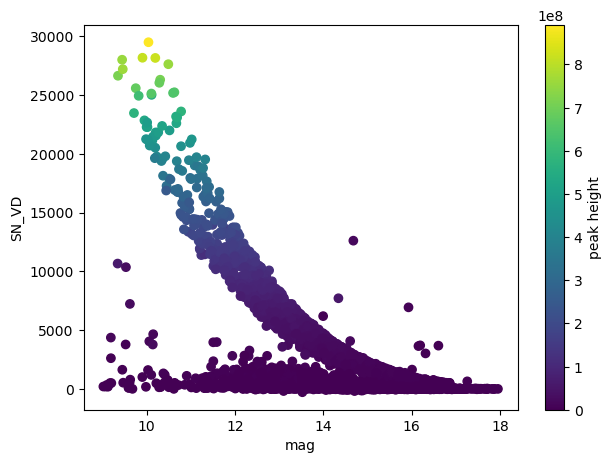

In [107]:
import matplotlib.pyplot as plt
fig,ax = plt.subplots(1,1,figsize=(7,5))
image = ax.scatter(summary['mag'], summary['SN_VD'],c=summary['PEAK_HEIGHT'])
ax.set_xlabel('mag')
ax.set_ylabel('SN_VD')
plt.colorbar(image, label='peak height')

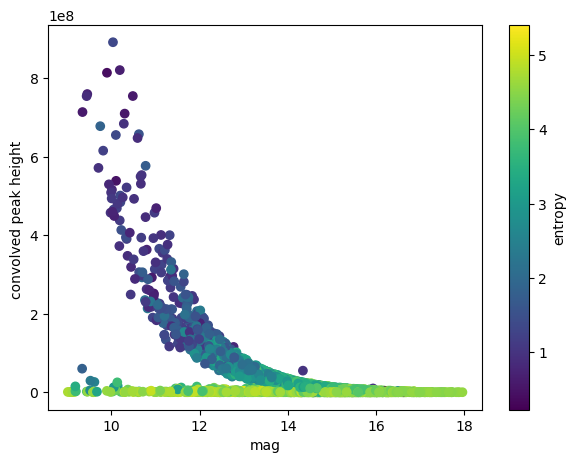

In [12]:
import matplotlib.pyplot as plt
fig,ax = plt.subplots(1,1,figsize=(7,5))
ax.set_xlabel('mag')
ax.set_ylabel('convolved peak height ')
plt.scatter(summary['mag'], summary['PEAK_HEIGHT'],c=summary['ENTROPY'])
plt.colorbar(label='entropy')

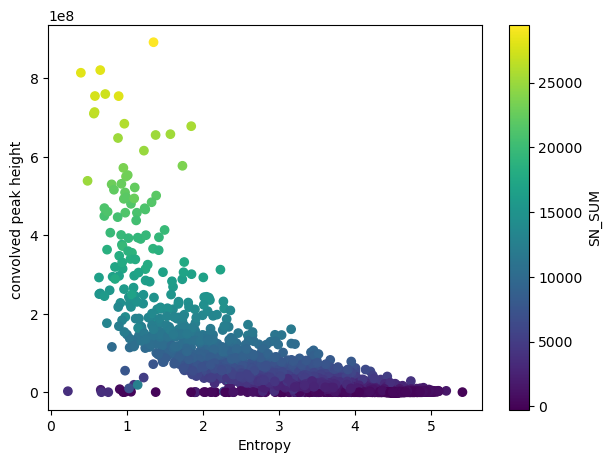

In [18]:
import matplotlib.pyplot as plt
fig,ax = plt.subplots(1,1,figsize=(7,5))
ax.set_xlabel('Entropy')
ax.set_ylabel('convolved peak height ')
plt.scatter(summary['ENTROPY'], summary['PEAK_HEIGHT'], c=summary['SN_SUM'])#,c=summary['ENTROPY'])
plt.colorbar(label='SN_SUM')

Look at the stamps of bright objects that have low SN .... What are the representatives of that bottom-left branch ? 


In [68]:
mask  = ( np.asarray(summary['mag'])<10 ) * ( np.asarray(summary['SN_VD']) < 5000)
det_names = np.asarray(summary['DET_NAME'])[mask]
donut_id = np.asarray(summary['ARCHIVE_IDS'])[mask]
snvd = np.asarray(summary['SN_VD'])[mask]
mags  = np.asarray(summary['mag'])[mask]
peaks = np.asarray(summary['PEAK_HEIGHT'])[mask]
meanBkg = np.asarray(summary['MEAN_IMAGE_BACKGROUND'])[mask]
entropy = np.asarray(summary['ENTROPY'])[mask]

In [52]:
det_name

array(['R10_S21', 'R11_S20', 'R13_S20', 'R13_S20', 'R20_S01', 'R20_S12',
       'R20_S21', 'R23_S22', 'R30_S11', 'R30_S11', 'R31_S11', 'R32_S10',
       'R33_S02', 'R33_S10', 'R34_S10', 'R34_S12', 'R41_S01', 'R41_S20',
       'R41_S22', 'R42_S22'], dtype='<U7')

In [53]:
donut_id

array([1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [ ]:
Consider these:

In [60]:
ref.dataId.detector

detector.RecordClass(instrument='LSSTCam', id=0, full_name='R01_S00', name_in_raft='S00', raft='R01', purpose='SCIENCE')

In [65]:
#plt.imshow(stamp.stamp_im.image.array, origin='lower')

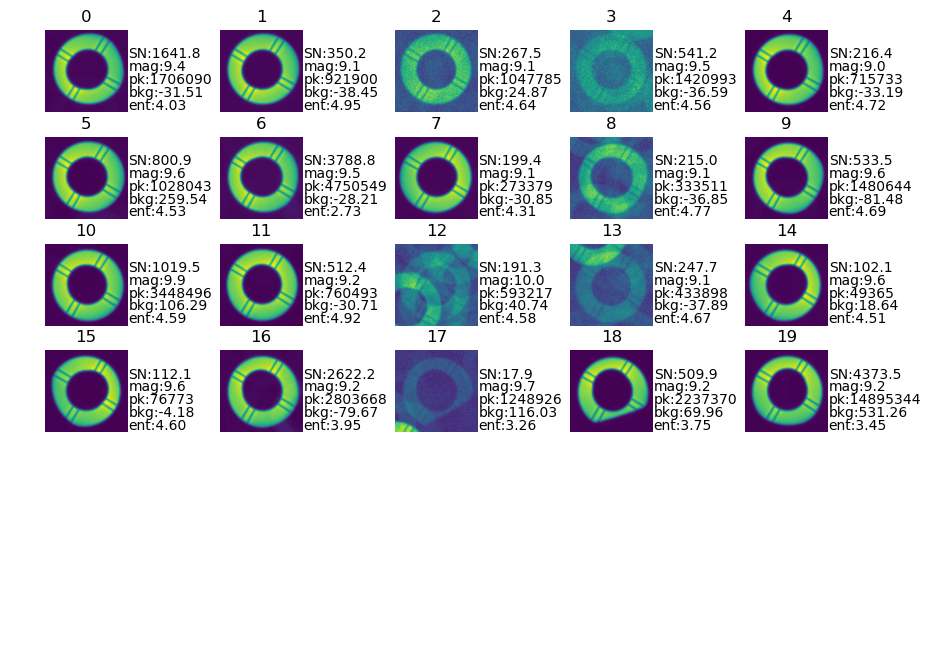

In [93]:
instrument = 'LSSTCam'
exposure_extra = 5028081800962

fig,axs = plt.subplots(6,5, figsize=(11,8))
ax = np.ravel(axs)
n = len(det_names)
ytop = 105
dy = 25
for i in range(len(det_names)):
    det_name = det_names[i]
    # get the dataId from all refs 
    for ref in refs:
        if ref.dataId.detector.full_name == det_name:
            refc = ref 
    donutStampsExtra = butler.get("donutStampsExtra", dataId=refc.dataId, 
                                  collections=[collection])
    stamp = donutStampsExtra[donut_id[i]]
    ax[i].imshow(stamp.stamp_im.image.array, origin='lower')
    color='k'
    ax[i].text(162,ytop,f"SN:{snvd[i]:.1f}", color=color)
    ax[i].text(162,ytop-dy, f"mag:{mags[i]:.1f}")
    ax[i].text(162,ytop-2*dy, f"pk:{peaks[i]:.0f}")
    ax[i].text(162,ytop-3*dy, f"bkg:{meanBkg[i]:.2f}")
    ax[i].text(162,ytop-4*dy, f"ent:{entropy[i]:.2f}")
    ax[i].set_title( i)
    ax[i].axis('off')
    
if n < len(ax):  
    for j in range(n, len(ax)):
        ax[j].axis('off')
fig.subplots_adjust(hspace=0.3)
fig.subplots_adjust(wspace=0.15)

ok, so this catches donuts that are clearly fine , but for some reason have a low SN... why?  why is the peak so low too?  Plot for these just the donut*mask...

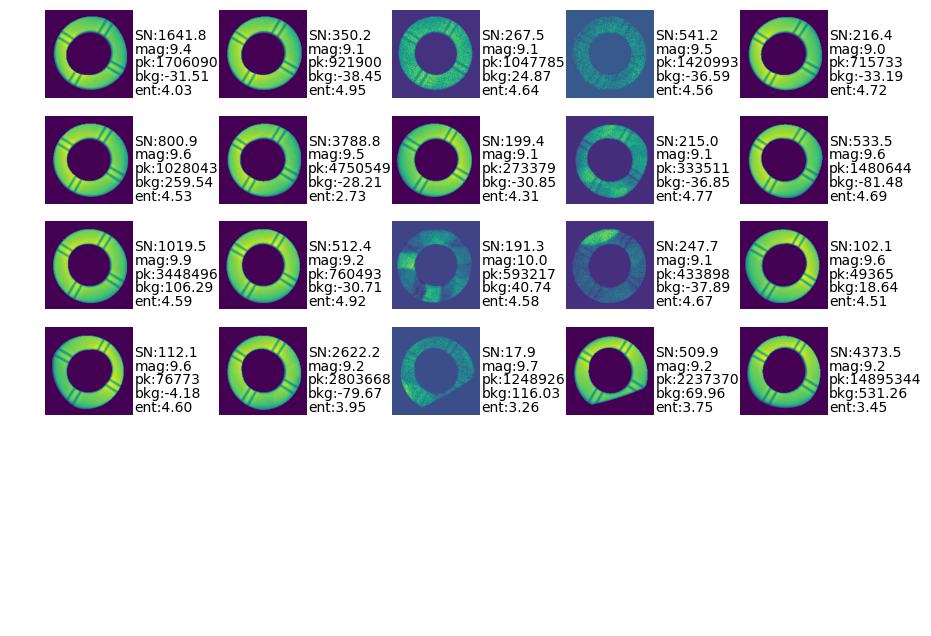

In [103]:
instrument = 'LSSTCam'
exposure_extra = 5028081800962

fig,axs = plt.subplots(6,5, figsize=(11,8))
ax = np.ravel(axs)
n = len(det_names)
ytop = 105
dy = 25
for i in range(len(det_names)):
    det_name = det_names[i]
    # get the dataId from all refs 
    for ref in refs:
        if ref.dataId.detector.full_name == det_name:
            refc = ref 
    donutStampsExtra = butler.get("donutStampsExtra", dataId=refc.dataId, 
                                  collections=[collection])
    stamp = donutStampsExtra[donut_id[i]]
    image = stamp.stamp_im.image.array
    donut_mask = stamp.stamp_im.mask.array
    m = ~(donut_mask > 0)
    #ax[i].imshow(image*donut_mask, origin='lower')
    ax[i].imshow(image*donut_mask, origin='lower')
    color='k'
    ax[i].text(162,ytop,f"SN:{snvd[i]:.1f}", color=color)
    ax[i].text(162,ytop-dy, f"mag:{mags[i]:.1f}")
    ax[i].text(162,ytop-2*dy, f"pk:{peaks[i]:.0f}")
    ax[i].text(162,ytop-3*dy, f"bkg:{meanBkg[i]:.2f}")
    ax[i].text(162,ytop-4*dy, f"ent:{entropy[i]:.2f}")
    ax[i].axis('off')
    
if n < len(ax):  
    for j in range(n, len(ax)):
        ax[j].axis('off')
fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0.1)

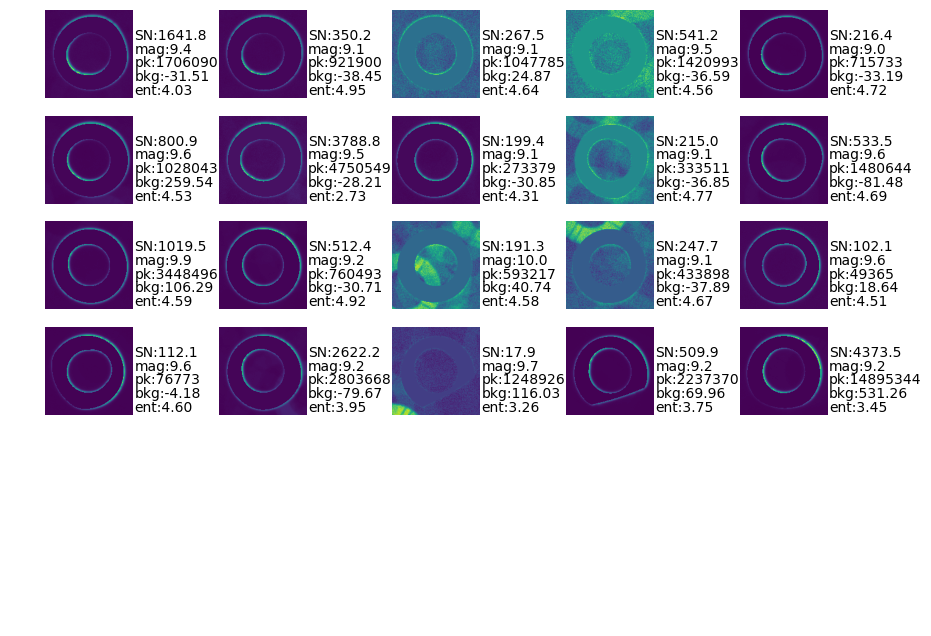

In [104]:
instrument = 'LSSTCam'
exposure_extra = 5028081800962

fig,axs = plt.subplots(6,5, figsize=(11,8))
ax = np.ravel(axs)
n = len(det_names)
ytop = 105
dy = 25
for i in range(len(det_names)):
    det_name = det_names[i]
    # get the dataId from all refs 
    for ref in refs:
        if ref.dataId.detector.full_name == det_name:
            refc = ref 
    donutStampsExtra = butler.get("donutStampsExtra", dataId=refc.dataId, 
                                  collections=[collection])
    stamp = donutStampsExtra[donut_id[i]]
    image = stamp.stamp_im.image.array
    donut_mask = stamp.stamp_im.mask.array
    m = ~(donut_mask > 0)
    #ax[i].imshow(image*donut_mask, origin='lower')
    ax[i].imshow(image*m, origin='lower')
    color='k'
    ax[i].text(162,ytop,f"SN:{snvd[i]:.1f}", color=color)
    ax[i].text(162,ytop-dy, f"mag:{mags[i]:.1f}")
    ax[i].text(162,ytop-2*dy, f"pk:{peaks[i]:.0f}")
    ax[i].text(162,ytop-3*dy, f"bkg:{meanBkg[i]:.2f}")
    ax[i].text(162,ytop-4*dy, f"ent:{entropy[i]:.2f}")
    ax[i].axis('off')
    
if n < len(ax):  
    for j in range(n, len(ax)):
        ax[j].axis('off')
fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0.1)

Show those that have very low peak height and large mag:

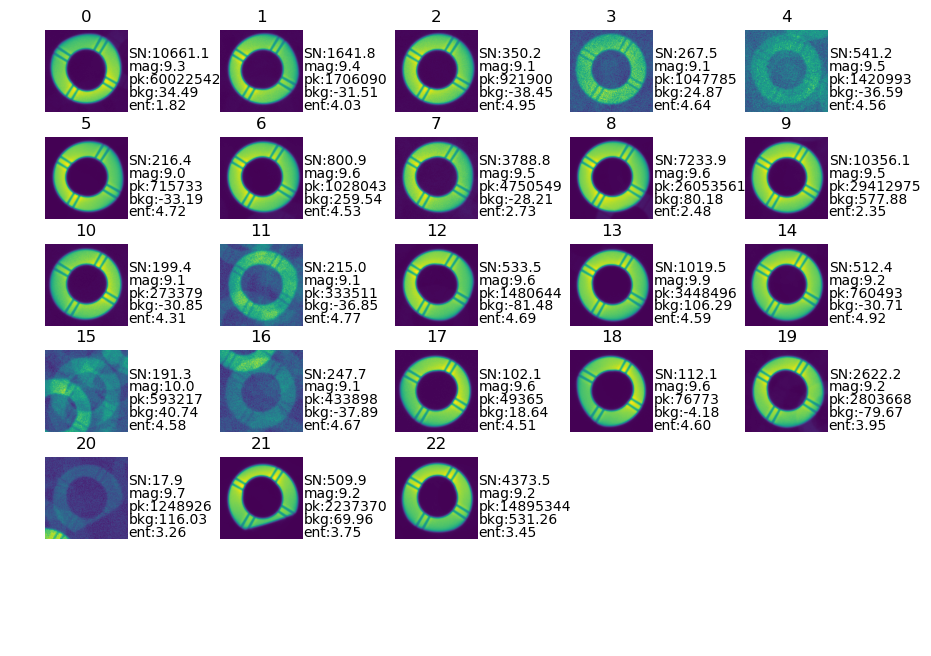

In [13]:
mask  = ( np.asarray(summary['mag'])<10 ) * ( np.asarray(summary['PEAK_HEIGHT']) < 1e8)
det_names = np.asarray(summary['DET_NAME'])[mask]
donut_id = np.asarray(summary['ARCHIVE_IDS'])[mask]
snvd = np.asarray(summary['SN_VD'])[mask]
mags  = np.asarray(summary['mag'])[mask]
peaks = np.asarray(summary['PEAK_HEIGHT'])[mask]
meanBkg = np.asarray(summary['MEAN_IMAGE_BACKGROUND'])[mask]
entropy = np.asarray(summary['ENTROPY'])[mask]


instrument = 'LSSTCam'
exposure_extra = 5028081800962

fig,axs = plt.subplots(6,5, figsize=(11,8))
ax = np.ravel(axs)
n = len(det_names)
ytop = 105
dy = 25
for i in range(len(det_names)):
    det_name = det_names[i]
    # get the dataId from all refs 
    for ref in refs:
        if ref.dataId.detector.full_name == det_name:
            refc = ref 
    donutStampsExtra = butler.get("donutStampsExtra", dataId=refc.dataId, 
                                  collections=[collection])
    stamp = donutStampsExtra[donut_id[i]]
    ax[i].imshow(stamp.stamp_im.image.array, origin='lower')
    color='k'
    ax[i].text(162,ytop,f"SN:{snvd[i]:.1f}", color=color)
    ax[i].text(162,ytop-dy, f"mag:{mags[i]:.1f}")
    ax[i].text(162,ytop-2*dy, f"pk:{peaks[i]:.0f}")
    ax[i].text(162,ytop-3*dy, f"bkg:{meanBkg[i]:.2f}")
    ax[i].text(162,ytop-4*dy, f"ent:{entropy[i]:.2f}")
    ax[i].set_title( i)
    ax[i].axis('off')
    
if n < len(ax):  
    for j in range(n, len(ax)):
        ax[j].axis('off')
fig.subplots_adjust(hspace=0.3)
fig.subplots_adjust(wspace=0.15)

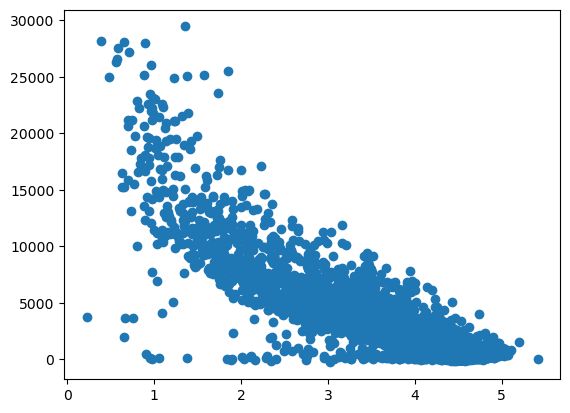

In [28]:
plt.scatter(summary['ENTROPY'], summary['SN_VD'])

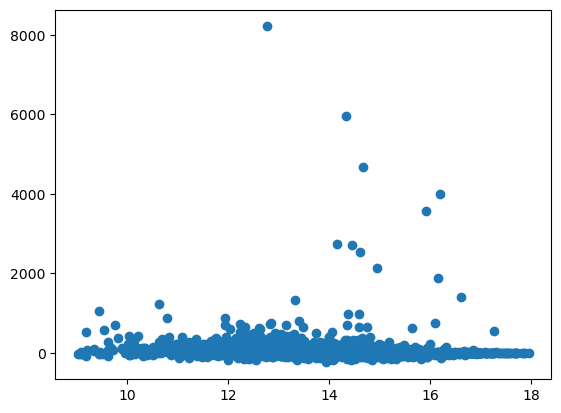

In [30]:
plt.scatter(summary['mag'], summary['MEAN_IMAGE_BACKGROUND'])

ok, so interestingly there are those that have very large mean background (if it were just plain donuts, the mean would be around 0 ..)

In [39]:
#plt.hexbin?

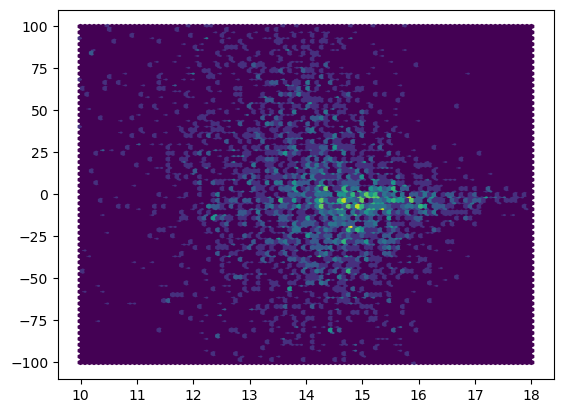

In [38]:
plt.hexbin(summary['mag'], summary['MEAN_IMAGE_BACKGROUND'], extent=(10,18,-100,100), bins=30)
#plt.ylim(-100,100)

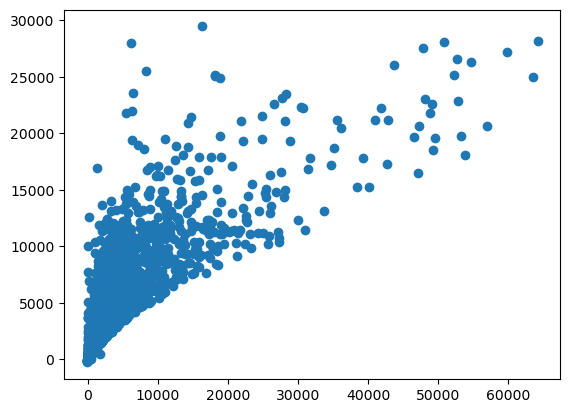

In [40]:
plt.scatter(summary['SN_VB'], summary['SN_VD'])

* Also plot  entropy  vs SN_VB,  and other quantities that I sent to Josh

* Clean up the ticket and reopen PR 

* Look again at Bryce's ticket 



# Find out the mag/flux of the source at the initial x/y, before re-centroiding

In [19]:
import lsst.daf.butler as dafButler
import os
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/'
butlerRootPath = os.path.join(path_cwd, 'gen3repo')
butler = dafButler.Butler(butlerRootPath)
collection = 'runFAM_960_962_2024_17_bps_all_science_var'
detector = 4
instrument = 'LSSTCam'
exposure_extra = 5028081800962
data_id_extra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_extra,
           "exposure":exposure_extra
          }
exposure_extra = butler.get("postISRCCD", dataId=data_id_extra, collections=[collection])


donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
print(len(donutCatalogExtra))


donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])
print(len(donutStampsExtra))


26
26


# Get peak height in the convolution step  in donut cutouts: 

It's part of the `calculateFinalCentroid`  in `cutOutDonutsBase.py` : 

In [2]:
import lsst.daf.butler as dafButler
import os
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/'
butlerRootPath = os.path.join(path_cwd, 'gen3repo')
butler = dafButler.Butler(butlerRootPath)
collection = 'runFAM_960_962_2024_17_bps_all_science_var'
detector = 4
instrument = 'LSSTCam'
exposure_extra = 5028081800962
data_id_extra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_extra,
           "exposure":exposure_extra
          }
exposure_extra = butler.get("postISRCCD", dataId=data_id_extra, collections=[collection])


donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
print(len(donutCatalogExtra))


donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])
print(len(donutStampsExtra))


26
26


In [22]:
donutCatalogExtra[:5]


,coord_ra,coord_dec,centroid_x,centroid_y,source_flux,blend_centroid_x,blend_centroid_y
0,4.778712,-0.099235,485.048772,1013.785092,4.685993e+07,[],[]
1,4.778487,-0.099436,208.598429,872.406034,4.588691e+07,[],[]
2,4.781221,-0.100321,363.450863,3824.612366,3.480820e+07,[],[]
3,4.779901,-0.098732,1409.002970,1970.893178,3.123024e+07,[],[]
4,4.780890,-0.099537,996.513695,3217.635152,2.495360e+07,[],[]


the information about the previous centroid is stored in the donut catalog as 
`centroid_x,   centroid_y`

the re-centroiding in cutoutDonutsBase is storead as an element of donutStamps metadata via 
`CENT_X,  CENT_Y`



Thus the magnitude was provided for the original source location from the reference catalog, NOT for the re-centroiding. Compare the sources with the positions of the reference catalog sources ... 

In [ ]:
This follows whats done in https://github.com/lsst-ts/ts_wep/blob/develop/python/lsst/ts/wep/task/generateDonutCatalogWcsTask.py#L41  and https://github.com/lsst-ts/ts_wep/blob/develop/python/lsst/ts/wep/task/generateDonutCatalogUtils.py#L62 

In [49]:
from lsst.meas.algorithms import LoadReferenceObjectsConfig

In [50]:
anyFilterMapsToThis = LoadReferenceObjectsConfig.anyFilterMapsToThis

In [55]:
#anyFilterMapsToThis.

In [56]:
import lsst.daf.butler as daf_butler
from lsst.meas.algorithms import ReferenceObjectLoader
from lsst.meas.algorithms import LoadReferenceObjectsConfig
import lsst.geom
import os
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/'
butlerRootPath = os.path.join(path_cwd, 'gen3repo')

collection='refcats/gaia_dr2_20200414' 
dstype='gaia_dr2_20200414'

butler = daf_butler.Butler(butlerRootPath,
                           collections=[collection])
refs = set(butler.registry.queryDatasets(dstype))

refCats = [daf_butler.DeferredDatasetHandle(butler, _, {})
           for _ in refs]
dataIds = [butler.registry.expandDataId(_.dataId) for _ in refs]

ref_obj_loader =  ReferenceObjectLoader(
            dataIds=dataIds,
            refCats=refCats,
            config=LoadReferenceObjectsConfig(anyFilterMapsToThis='phot_g_mean'),)

In [39]:
detector = exposure_extra.getDetector()
detectorWcs = exposure_extra.getWcs()
bbox = detector.getBBox()
filterName =  exposure_extra.filter.bandLabel
donCat = ref_obj_loader.loadPixelBox(bbox, detectorWcs, filterName).refCat

INFO:lsst.meas.algorithms.loadReferenceObjects.ReferenceObjectLoader:Loading reference objects from None in region bounded by [273.71244643, 274.05188957], [-5.79538828, -5.45464144] RA Dec
INFO:lsst.meas.algorithms.loadReferenceObjects.ReferenceObjectLoader:Loaded 16368 reference objects


In this catalog, the fields phot_g_mean_flux and anyFilterMapsToThis contain identical measures of flux. 

In [48]:
donCat.asAstropy().colnames

['id',
 'coord_ra',
 'coord_dec',
 'phot_g_mean_flux',
 'anyFilterMapsToThis',
 'phot_bp_mean_flux',
 'phot_rp_mean_flux',
 'phot_g_mean_fluxErr',
 'anyFilterMapsToThisErr',
 'phot_bp_mean_fluxErr',
 'phot_rp_mean_fluxErr',
 'coord_raErr',
 'coord_decErr',
 'epoch',
 'pm_ra',
 'pm_dec',
 'pm_raErr',
 'pm_decErr',
 'pm_flag',
 'parallax',
 'parallaxErr',
 'parallax_flag',
 'astrometric_excess_noise',
 'phot_variable_flag',
 'centroid_x',
 'slot_Centroid_x',
 'centroid_y',
 'slot_Centroid_y',
 'hasCentroid']

In [99]:
donCat.asAstropy()[:5]

id,coord_ra,coord_dec,phot_g_mean_flux,anyFilterMapsToThis,phot_bp_mean_flux,phot_rp_mean_flux,phot_g_mean_fluxErr,anyFilterMapsToThisErr,phot_bp_mean_fluxErr,phot_rp_mean_fluxErr,coord_raErr,coord_decErr,epoch,pm_ra,pm_dec,pm_raErr,pm_decErr,pm_flag,parallax,parallaxErr,parallax_flag,astrometric_excess_noise,phot_variable_flag,centroid_x,slot_Centroid_x,centroid_y,slot_Centroid_y,hasCentroid
,rad,rad,nJy,nJy,nJy,nJy,nJy,nJy,nJy,nJy,rad,rad,d,rad,rad,rad / yr,rad / yr,,rad,rad,,,,,,,,
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float32,float32,float64,float64,float64,float32,float32,bool,float64,float64,bool,float64,str52,float64,float64,float64,float64,bool
4172844440739379712,4.778584830547549,-0.09801548815325824,35281.475251358715,35281.475251358715,17880.236157267973,111062.65628527156,320.6500858789963,320.6500858789963,4072.2473081543562,9663.343825511258,2.984104e-09,5.252868e-09,57205.87440946643,8.38658721876821e-09,2.413875290332583e-09,5.9096856e-09,5.949248e-09,False,9.546674842648885e-09,6.69646738499333e-09,False,1.2716382471225198,NOT_AVAILABLE,1614.2366304130592,1614.2366304130592,441.4950168937103,441.4950168937103,True
4172844165861243776,4.778886583963574,-0.09835041120234737,32936.99697103035,32936.99697103035,11491.651364287503,58666.718852323116,278.34013107170694,278.34013107170694,4536.999725247947,6428.5260240096595,2.9187317e-09,5.16049e-09,57205.87440946643,-1.5764835082456506e-08,-1.690799462282473e-08,5.778925e-09,5.865422e-09,False,7.785724234643928e-10,6.600404614201299e-09,False,0.0,NOT_AVAILABLE,1402.6322267202486,1402.6322267202486,855.173970383039,855.173970383039,True
4172844505152666368,4.77824842958727,-0.09789888118692056,65967.07813082618,65967.07813082618,32399.12796213943,162050.50160365822,301.3733315724325,301.3733315724325,2283.959977327522,8902.36080229103,1.8538745e-09,3.246212e-09,57205.87440946643,-7.676167947357177e-10,-6.083365346795016e-09,3.6352803e-09,3.66878e-09,False,-2.2708718402073808e-09,4.102043285061442e-09,False,0.8338217916785619,NOT_AVAILABLE,1602.6171686528978,1602.6171686528978,75.12110154641414,75.12110154641414,True
4172843409946836608,4.779113073829956,-0.09855578063413208,23821.692941371413,23821.692941371413,20795.519735915124,51999.20324624664,218.1490293504192,218.1490293504192,7599.597549667081,5475.184399007085,3.927601e-09,1.5421406e-08,57205.87440946643,0.0,0.0,0.0,0.0,False,0.0,0.0,False,0.0,NOT_AVAILABLE,1288.1546784125403,1288.1546784125403,1148.650758595595,1148.650758595595,True
4172844131501499520,4.778733364312616,-0.09849907069681751,23258.665630619456,23258.665630619456,13638.388087753681,49726.751150948454,240.32893713099764,240.32893713099764,2926.1263351500806,5779.044226923419,4.8150217e-09,8.7196375e-09,57205.87440946643,-1.025799717037676e-08,-4.993047767093581e-08,1.0497761e-08,8.916373e-09,False,-8.729598399702788e-09,1.0311670830286918e-08,False,0.0,NOT_AVAILABLE,1202.858041116664,1202.858041116664,762.8434895582686,762.8434895582686,True


In [28]:
from lsst.ts.wep.task.donutSourceSelectorTask import DonutSourceSelectorTask

In [29]:
donutSelector = DonutSourceSelectorTask()

In [62]:
donutSelector.config.useCustomMagLimit  = True

In [64]:
donutSelection = donutSelector.run(donCat, detector, 'phot_g_mean')

INFO:lsst.donutSourceSelectorTask:Selected 26/16368 references


In [75]:
refSelection, blendCentersX, blendCentersY  = [donCat[donutSelection.selected], 
         donutSelection.blendCentersX,
         donutSelection.blendCentersY]

In [79]:
from lsst.ts.wep.task.generateDonutCatalogUtils import (
    donutCatalogToDataFrame)


array([1070.10239299, 1162.10525922, 2894.61323868, 3108.10833276,
       2976.98257361, 3781.57688969, 3582.59165697, 1724.95486532,
       2932.89688745, 2023.12478406, 3507.34571981,  531.8411596 ,
        363.45086273,  681.60431494, 1157.75428254,  750.9493856 ,
        485.04877243,  208.59842897, 1265.45173401, 1126.88308981,
       1710.7758102 ,  996.51369521, 1880.45662318, 1180.98765291,
       1409.00296989, 1464.82483857])

In [90]:
refSelection['anyFilterMapsToThis']

array([ 6003710.711186  , 16223841.47098128,  2334550.85815918,
       10725268.99185269,  8320345.19070512,  3223792.03649364,
       11126786.29266309,  3584722.5773269 ,  5873786.77736061,
       17912725.53010147, 19340967.33629808, 16013406.93705907,
       34808204.60353587,  5789265.06607694, 19021281.40624522,
        4013140.71289871, 46859926.60046321, 45886910.86277217,
       17555108.26281629,  6016743.23510437,  3662672.47125629,
       24953600.12910213,  3879821.31502148, 16121333.32743761,
       31230244.43948756,  8817658.72033367])

In [93]:
refSelection['phot_g_mean_flux']

array([ 6003710.711186  , 16223841.47098128,  2334550.85815918,
       10725268.99185269,  8320345.19070512,  3223792.03649364,
       11126786.29266309,  3584722.5773269 ,  5873786.77736061,
       17912725.53010147, 19340967.33629808, 16013406.93705907,
       34808204.60353587,  5789265.06607694, 19021281.40624522,
        4013140.71289871, 46859926.60046321, 45886910.86277217,
       17555108.26281629,  6016743.23510437,  3662672.47125629,
       24953600.12910213,  3879821.31502148, 16121333.32743761,
       31230244.43948756,  8817658.72033367])

In [94]:
filterName = 'phot_g_mean'
fieldObjects = donutCatalogToDataFrame(
            refSelection, filterName, blendCentersX, blendCentersY
        )

In [97]:
donutCatalogExtra[:5]

,coord_ra,coord_dec,centroid_x,centroid_y,source_flux,blend_centroid_x,blend_centroid_y
0,4.778712,-0.099235,485.048772,1013.785092,4.685993e+07,[],[]
1,4.778487,-0.099436,208.598429,872.406034,4.588691e+07,[],[]
2,4.781221,-0.100321,363.450863,3824.612366,3.480820e+07,[],[]
3,4.779901,-0.098732,1409.002970,1970.893178,3.123024e+07,[],[]
4,4.780890,-0.099537,996.513695,3217.635152,2.495360e+07,[],[]


In [96]:
fieldObjects[:5]

,coord_ra,coord_dec,centroid_x,centroid_y,source_flux,blend_centroid_x,blend_centroid_y
0,4.778712,-0.099235,485.048772,1013.785092,4.685993e+07,[],[]
1,4.778487,-0.099436,208.598429,872.406034,4.588691e+07,[],[]
2,4.781221,-0.100321,363.450863,3824.612366,3.480820e+07,[],[]
3,4.779901,-0.098732,1409.002970,1970.893178,3.123024e+07,[],[]
4,4.780890,-0.099537,996.513695,3217.635152,2.495360e+07,[],[]


ok, so this confirms that the donut catalog positions of `centroid_x`, `centroid_y` are exactly the positions from the reference catalog.

This means that when we plot the magnitude, we are plotting hte magnitude of the original refcat source, before the re-centroiding.  

Plot the exposure with the `centroid_x`,  `centroid_y`,  as well as `CENT_X`,  `CENT_Y`   - does any go beyond the donut? Plot an arrow from an old location to new locaito 

In [3]:
x1, y1 = donutCatalogExtra['centroid_x'].values,donutCatalogExtra['centroid_y'].values


In [109]:
x1

array([ 485.04877243,  208.59842897,  363.45086273, 1409.00296989,
        996.51369521, 3507.34571981, 1157.75428254, 2023.12478406,
       1265.45173401, 1162.10525922, 1180.98765291,  531.8411596 ,
       3582.59165697, 3108.10833276, 1464.82483857, 2976.98257361,
       1126.88308981, 1070.10239299, 2932.89688745,  681.60431494,
        750.9493856 , 1880.45662318, 1710.7758102 , 1724.95486532,
       3781.57688969, 2894.61323868])

In [4]:
x2, y2 = donutStampsExtra.metadata.getArray('CENT_X'),donutStampsExtra.metadata.getArray('CENT_Y')

In [5]:
import astropy.units as u
mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)

In [121]:

mags

array([12.22299599, 12.24577795, 12.54579594, 12.66356154, 12.90716697,
       13.18380452, 13.20190057, 13.26709582, 13.28899122, 13.37461576,
       13.38149761, 13.38879065, 13.78407563, 13.82397952, 14.03661679,
       14.09964664, 14.4515963 , 14.45395061, 14.47770456, 14.49344141,
       14.89128903, 14.92797069, 14.99050479, 15.01386112, 15.12908245,
       15.47949165])

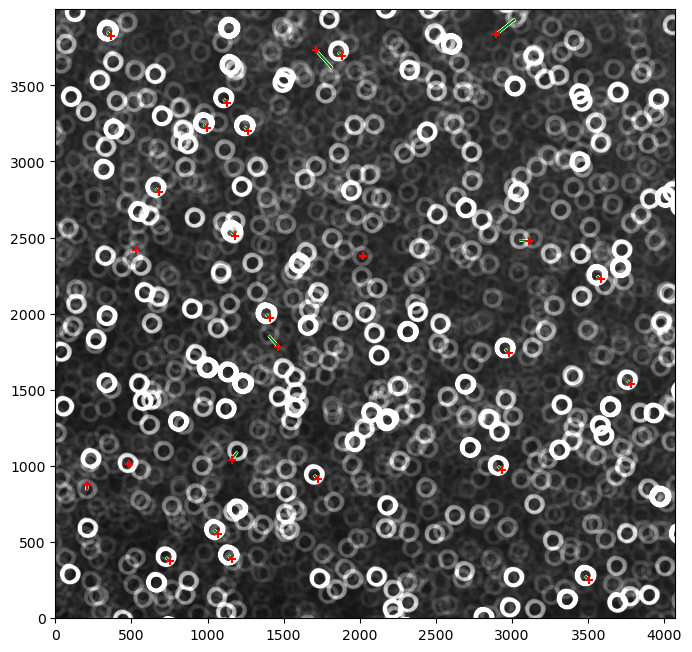

In [27]:
# adding a stroke to an arrow 
# https://matplotlib.org/stable/gallery/misc/patheffect_demo.html#sphx-glr-gallery-misc-patheffect-demo-py
from astropy.visualization import ZScaleInterval
import matplotlib.pyplot as plt 
from matplotlib import patheffects

image = exposure_extra.image.array
zscale = ZScaleInterval()
vmin,vmax = zscale.get_limits(image)
fig,ax = plt.subplots(1,1,figsize=(8,8))
ax.imshow(image, vmin=vmin, vmax=vmax, origin="lower", cmap='gray')


# plot the arrow first 
pe = [patheffects.withStroke(linewidth=2,
                             foreground="w")]
for i in range(len(x1)):
    ax.arrow(x1[i],y1[i],  x2[i]-x1[i],  y2[i]-y1[i], head_width=0.2, width=0.2,
            color='g', path_effects=pe) 
    
# put the original donut location on top of the arrow 
ax.scatter(x1,y1,marker='+', c='r',s=35)



In [28]:
#ax.arrow?

These steps are common for all donuts in the detector : 

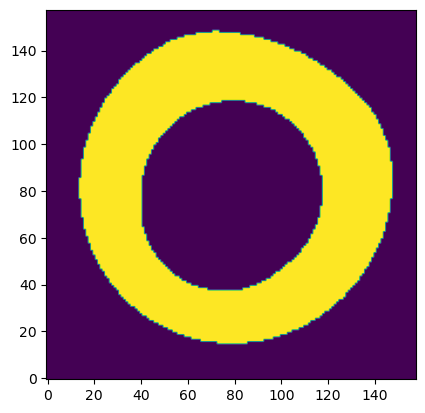

In [30]:
from lsst.ts.wep.utils import (
    createTemplateForDetector,
    getOffsetFromExposure,
    getTaskInstrument,)
from lsst.ts.wep.utils import DefocalType

import matplotlib.pyplot as plt 

exposure = exposure_extra
donutCatalog = donutCatalogExtra

detector = exposure.getDetector()
detectorName = detector.getName()
bandLabel = exposure.filter.bandLabel

cameraName = "LSSTCam"


defocalType = DefocalType.Extra
offset = getOffsetFromExposure(exposure, cameraName, defocalType)

instConfigFile = "policy:instruments/LsstFamCam.yaml"

# Load the instrument
instrument = getTaskInstrument(
    cameraName,
    detectorName,
    offset,
    instConfigFile,
)
opticalModel = 'offAxis'

initialCutoutPadding = 5 # defaulkt 

# Calculate a template for a detector
template = createTemplateForDetector(
            detector=detector,
            defocalType=defocalType,
            bandLabel=bandLabel,
            instrument=instrument,
            opticalModel=opticalModel,
            padding=initialCutoutPadding,
            binary=True,
        )



plt.imshow(template, origin='lower')

Next steps are repeated for each donut in the catalog : 

In [31]:
def shiftCenter( center, boundary, distance):
    """Shift the center if its distance to boundary is less than required.

    Parameters
    ----------
    center : float
        Center point.
    boundary : float
        Boundary point.
    distance : float
        Required distance.

    Returns
    -------
    float
        Shifted center.
    """

    # Distance between the center and boundary
    delta = boundary - center

    # Shift the center if needed
    if abs(delta) < distance:
        return boundary - np.sign(delta) * distance
    else:
        return center


In [151]:
mags

array([12.22299599, 12.24577795, 12.54579594, 12.66356154, 12.90716697,
       13.18380452, 13.20190057, 13.26709582, 13.28899122, 13.37461576,
       13.38149761, 13.38879065, 13.78407563, 13.82397952, 14.03661679,
       14.09964664, 14.4515963 , 14.45395061, 14.47770456, 14.49344141,
       14.89128903, 14.92797069, 14.99050479, 15.01386112, 15.12908245,
       15.47949165])

In [32]:
donutCatalog['mag'] = mags
#for donutRow in donutCatalog.to_records():
#    print(donutRow['mag'])

485 1013
476 1014
208 872
208 849
363 3824
343 3848
1409 1970
1386 1994
996 3217
976 3242
3507 252
3483 275
1157 1041
1172 1056
2023 2379
2015 2370
1265 3202
1244 3225
1162 385
1139 409
1180 2513
1159 2536
531 2417
525 2402
3582 2225
3559 2247
3108 2478
3124 2486
1464 1783
1448 1773
2976 1743
2954 1766
1126 3384
1105 3406
1070 552
1047 576
2932 973
2909 996
681 2799
660 2821
750 373
727 397
1880 3692
1859 3713
1710 3731
1725 3709


/tmp/ipykernel_6891/837301713.py:87: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax = plt.subplots(1,4,figsize=(14,4))


1724 914
1701 936
3781 1537
3759 1557
2894 3834
2902 3812


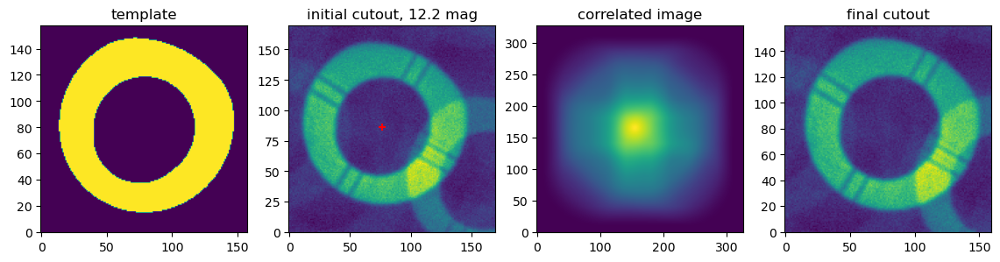

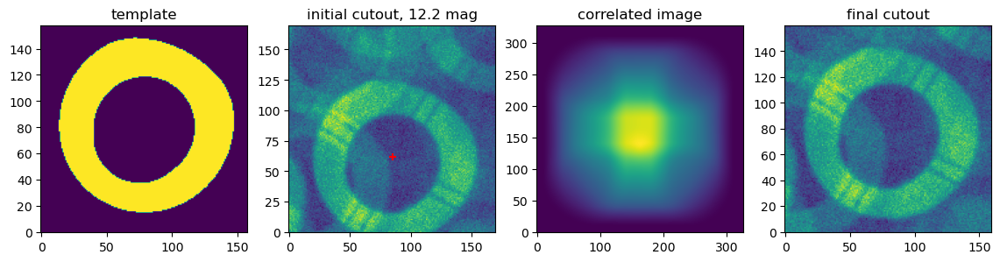

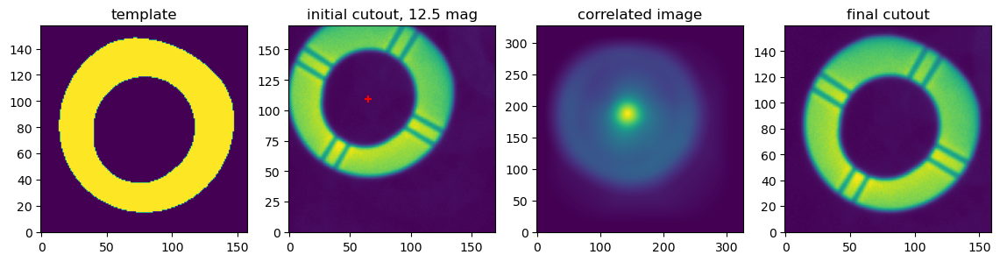

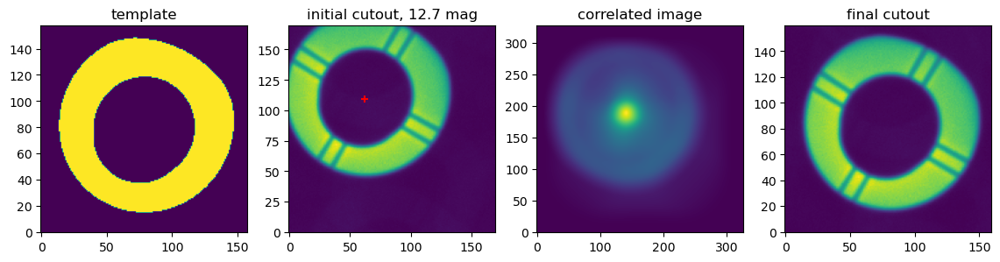

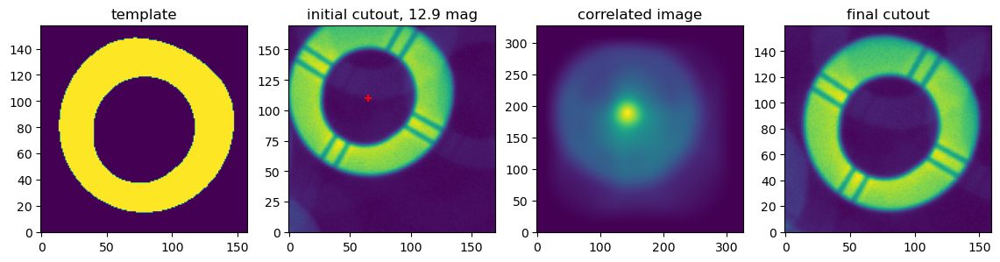

...

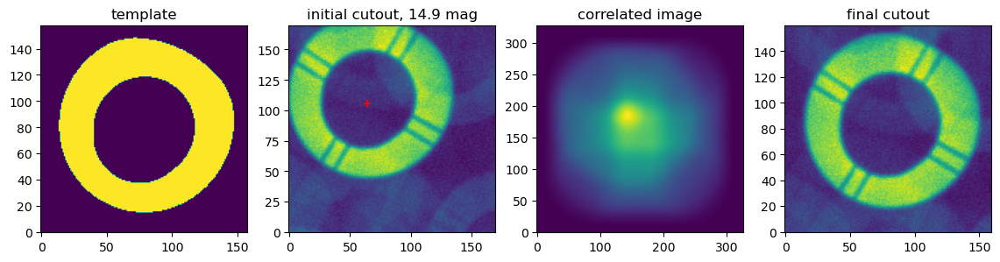

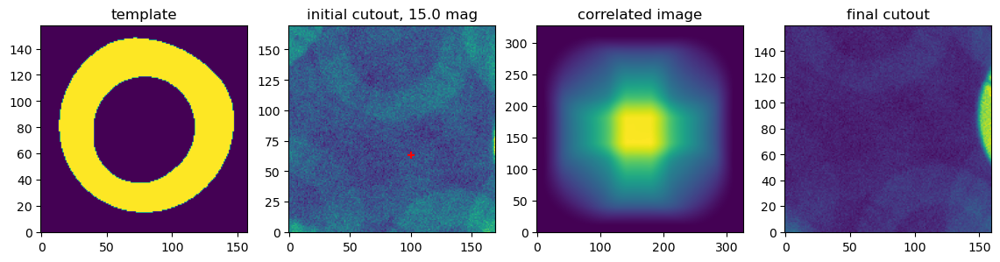

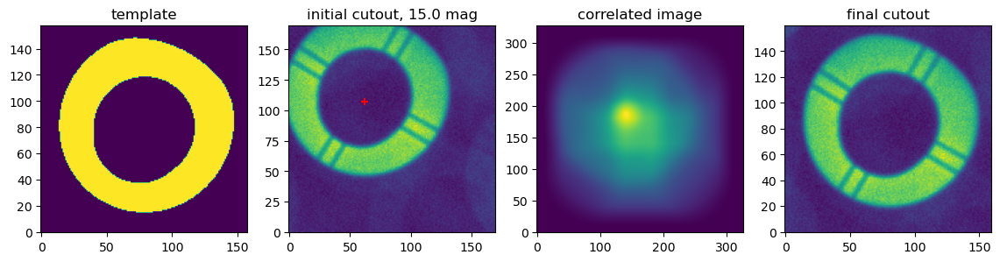

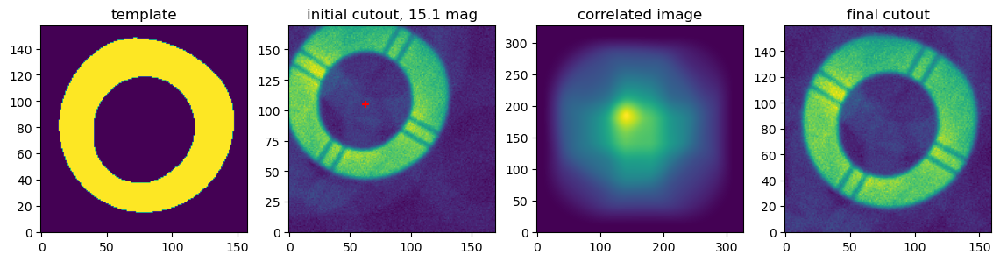

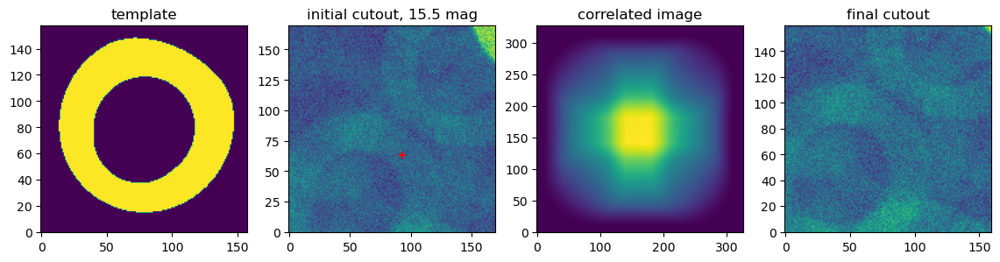

In [33]:

from lsst.geom import Point2D, degrees
import lsst.geom 

from scipy.signal import correlate
import numpy as np 

i = 0 
for donutRow in donutCatalog.to_records():
    #donutRow = donutCatalog.to_records()
    donutStampSize  = 160
    
    expDim = exposure.getDimensions()
    initialCutoutSize = donutStampSize + (2 * initialCutoutPadding)
    initialHalfWidth = int(initialCutoutSize / 2)
    stampHalfWidth = int(donutStampSize / 2)
    
    #donutRow in donutCatalog.to_records()
    xCent = int(donutRow["centroid_x"])
    yCent = int(donutRow["centroid_y"])
    print(xCent,yCent)
    
    
    # Shift stamp center if necessary
    xCent = shiftCenter(xCent, expDim.getX(), initialHalfWidth)
    xCent = shiftCenter(xCent, 0, initialHalfWidth)
    yCent = shiftCenter(yCent, expDim.getY(), initialHalfWidth)
    yCent = shiftCenter(yCent, 0, initialHalfWidth)
    
    #print(xCent,yCent)
    # Stamp BBox defined by corner pixel and extent
    initXCorner = xCent - initialHalfWidth
    initYCorner = yCent - initialHalfWidth
    
  
    # Define BBox and get cutout from exposure
    initCornerPoint = lsst.geom.Point2I(initXCorner, initYCorner)
    initBBox = lsst.geom.Box2I(
        initCornerPoint, lsst.geom.Extent2I(initialCutoutSize)
    )
    initialCutout = exposure[initBBox]

    
    # Find the centroid by finding the max point in an initial
    # cutout convolved with a template
    correlatedImage = correlate(initialCutout.image.array, template)
    maxIdx = np.argmax(correlatedImage)
    maxLoc = np.unravel_index(maxIdx, np.shape(correlatedImage))
    
    templateHalfWidth = int(len(template) / 2)
    newX = maxLoc[1] - templateHalfWidth
    newY = maxLoc[0] - templateHalfWidth
    
    finalDonutX = xCent + (newX - initialHalfWidth)
    finalDonutY = yCent + (newY - initialHalfWidth)

     # Shift stamp center if necessary but not final centroid definition
    xStampCent = shiftCenter(finalDonutX, expDim.getX(), stampHalfWidth)
    xStampCent = shiftCenter(xStampCent, 0, stampHalfWidth)
    yStampCent = shiftCenter(finalDonutY, expDim.getY(), stampHalfWidth)
    yStampCent =  shiftCenter(yStampCent, 0, stampHalfWidth)

    # Define corner for final stamp BBox
    xCorner = xStampCent - stampHalfWidth
    yCorner = yStampCent - stampHalfWidth

   #  finalDonutX, finalDonutY, xCorner, yCorner  returned to cutOutStamps().. 
    print(finalDonutX, finalDonutY)


    xShift = finalDonutX - xCent
    yShift = finalDonutY - yCent
    #finalXCentList.append(finalDonutX)
    #finalYCentList.append(finalDonutY)

    # Get the final cutout
    finalCorner = lsst.geom.Point2I(xCorner, yCorner)
    finalBBox = lsst.geom.Box2I(
        finalCorner, lsst.geom.Extent2I(donutStampSize)
    )
    #xCornerList.append(xCorner)
    #yCornerList.append(yCorner)
    finalCutout = exposure[finalBBox].clone()


    peakHeight = correlatedImage[maxLoc]
    
    fig,ax = plt.subplots(1,4,figsize=(14,4))
    ax[0].imshow(template, origin='lower')
    ax[0].set_title('template')
    ax[1].imshow(initialCutout.image.array,origin='lower')
    magnitude = donutRow['mag']
    ax[1].set_title(f'initial cutout, {magnitude:.1f} mag')
    ax[2].imshow(correlatedImage,origin='lower')
    ax[2].set_title('correlated image')
    ax[1].scatter(newX,newY,c='red', marker='+')
    ax[3].imshow(finalCutout.image.array, origin='lower')
    ax[3].set_title('final cutout')

In [135]:
#$plt.imshow(initialCutout.image.array)

In [7]:
#def calculateFinalCentroid(self, exposure, template, xCent, yCent):
# """
# Recentroid donut from catalog values by convolving with template.
# Also return the appropriate corner values for the final donutStamp
# taking into account donut possibly being near the edges of the
# exposure and compensating appropriately.

# Parameters
# ----------
# exposure : lsst.afw.image.Exposure
#     Exposure with the donut image.
# template : numpy.ndarray
#     Donut template for the exposure.
# xCent : int
#     X pixel donut center from donutCatalog.
# yCent : int
#     Y pixel donut center from donutCatalog.

# Returns
# -------
# int
#     Final donut x centroid pixel position on exposure.
# int
#     Final donut y centroid pixel position on exposure.
# int
#     Final x corner position on exposure for donutStamp BBox.
# int
#     Final y corner position on exposure for donutStamp BBox.
# """

In [29]:
expDim

Extent2I(4072, 4000)

Text(0.5, 1.0, 'correlated image')

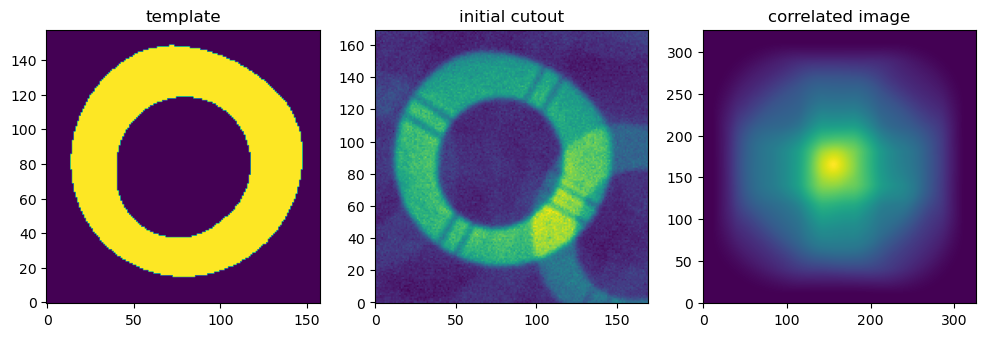

NameError: name 'template' is not defined

In [47]:
maxIdx

54110

## Run donut cutouts in the notebook to show that the PEAK HEIGHT retrieval  works 

(need to restart the kernel so cell below is self-contained):

In [14]:
from lsst.ts.wep.task.cutOutDonutsScienceSensorTask import (
CutOutDonutsScienceSensorTask,CutOutDonutsScienceSensorTaskConfig )

import os 
import lsst.daf.butler as dafButler
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41957_lsstCam_sweep/'
butlerRootPath = os.path.join(path_cwd, 'gen3repo')
butler = dafButler.Butler(butlerRootPath)

# note - to be able to calculate the SN_var,  
# we need to have variance...

inputRun = 'run_739388_var'
detector = 34
instrument = 'LSSTCam'
exposure_extra = 5028081800962
exposure_intra = 5028081800960
# construct a dataId for zernikes and donut catalog:
# switch exposure to visit
data_id_extra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_extra,
           "exposure":exposure_extra
          }

data_id_intra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_intra,
           "exposure":exposure_intra
          }


exposure_intra = butler.get("postISRCCD", dataId=data_id_intra, collections=[inputRun])
exposure_extra = butler.get("postISRCCD", dataId=data_id_extra, collections=[inputRun])


collection = 'runFAM_960_962_all_det_2023_47_ext_lim_11-15_bps'
#collection='runFAM_det160-161_1'
donutCatalogExtra = butler.get("donutCatalog", dataId=data_id_extra, collections=[collection])
print(len(donutCatalogExtra))


donutCatalogIntra = butler.get("donutCatalog", dataId=data_id_intra, collections=[collection])
print(len(donutCatalogIntra))

camera = butler.get("camera", dataId = data_id_extra, collections=[collection])

config = CutOutDonutsScienceSensorTaskConfig()
cutoutTask = CutOutDonutsScienceSensorTask(config=config)

cutouts = cutoutTask.run([exposure_extra, exposure_intra],
                         [donutCatalogExtra,donutCatalogIntra],
                         camera)

13
13


In [15]:
list(cutouts.donutStampsExtra.metadata)

['RA_DEG',
 'DEC_DEG',
 'DET_NAME',
 'CAM_NAME',
 'DFC_TYPE',
 'DFC_DIST',
 'CENT_X',
 'CENT_Y',
 'BLEND_CX',
 'BLEND_CY',
 'X0',
 'Y0',
 'SN',
 'SIGNAL',
 'NOISE',
 'NOISE_VAR',
 'SN_VAR',
 'STDEV_BKGD',
 'SQRT_VAR_BGKD',
 'EFFECTIVE',
 'ENTROPY',
 'PEAK_HEIGHT']

In [16]:
cutouts.donutStampsExtra.metadata.getArray('STDEV_BKGD')

[67.1330337524414,
 150.48565673828125,
 107.95118713378906,
 224.39259338378906,
 61.40376663208008,
 190.88272094726562,
 177.65760803222656,
 70.26131439208984,
 297.5894775390625,
 324.77374267578125,
 72.30374908447266,
 201.64938354492188,
 158.47396850585938]

In [17]:
cutouts.donutStampsExtra.metadata.getArray('SQRT_VAR_BGKD')

[45.35205078125,
 46.18202209472656,
 45.07880783081055,
 47.307228088378906,
 45.01359176635742,
 45.812320709228516,
 45.585636138916016,
 45.11174774169922,
 47.74916076660156,
 46.67580795288086,
 44.72223663330078,
 45.18556213378906,
 45.28575897216797]

In [18]:
heights = cutouts.donutStampsExtra.metadata.getArray('PEAK_HEIGHT')

In [19]:
heights

[82981353.64361376,
 159352081.70445573,
 5929523.613272056,
 78236941.00966203,
 62794005.605262965,
 35294044.7400602,
 1407916.7478011332,
 40299113.134556085,
 149983.86683714582,
 623656.5504028258,
 2828.545210737181,
 423308.96531698335,
 11642069.879146876]

In [13]:
stamp = donutStampsExtra[0]

In [ ]:
donutCatalog

Text(0.5, 0.98, 'R10_S21')

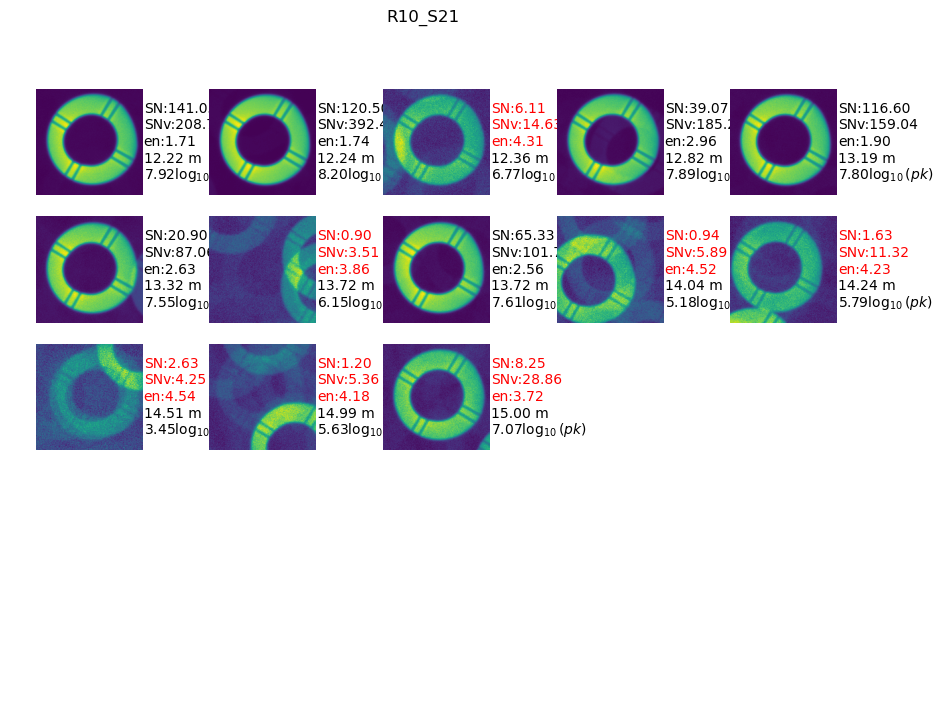

In [31]:
donutStampsExtra =  cutouts.donutStampsExtra

%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import astropy.units as u

mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)

effective = donutStampsExtra.metadata.getArray('EFFECTIVE')
sn_arr = donutStampsExtra.metadata.getArray('SN')
snvar_arr = donutStampsExtra.metadata.getArray('SN_VAR')
entropy = donutStampsExtra.metadata.getArray('ENTROPY')

fig,axs = plt.subplots(5,5, figsize=(11,8))
ax = np.ravel(axs)

mags = (donutCatalogExtra['source_flux'].values * u.nJy).to_value(u.ABmag)

ytop = 125
dy = 25
n = len(donutStampsExtra)
for i in range(len(donutStampsExtra)):
    ax[i].imshow(donutStampsExtra[i].stamp_im.image.array, origin='lower')
    color = 'black' 
    sn = sn_arr[i]
    if sn < 20:
        color='red'
    ax[i].text(162,ytop,f"SN:{sn:.2f}", color=color)
    ax[i].text(162,ytop-dy,f"SNv:{snvar_arr[i]:.2f}", color=color)


    en = entropy[i] < 3.5
    color = 'black' 
    if not en:
        color='red'
    ax[i].text(162,ytop-2*dy,f"en:{entropy[i]:.2f}", color=color)
    ax[i].text(162,ytop-3*dy, f"{mags[i]:.2f} m")
    ax[i].text(162,ytop-4*dy, f"{np.log10(heights[i]):.2f}"+r"$\log_{10}(pk)$")
    
    ax[i].axis('off')
if n < len(ax):  
    for j in range(n, len(ax)):
        ax[j].axis('off')
fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0.1)
fig.suptitle(donutStampsExtra.getDetectorNames()[0])

## Aside: debugging calculateSN function with stamps cut out earlier 

In [20]:
collection = 'runFAM_960_962_2024_13_ext_bps_93-94'

detector = 94
instrument = 'LSSTCam'
exposure_extra = 5028081800962
exposure_intra = 5028081800962
# construct a dataId for zernikes and donut catalog:
# switch exposure to visit
data_id_extra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_extra,
           "exposure":exposure_extra
          }

data_id_intra = {"detector": detector, 
           "instrument": instrument, 
           "visit": exposure_intra,
           "exposure":exposure_intra
          }



donutStampsExtra = butler.get("donutStampsExtra", dataId=data_id_extra, collections=[collection])
print(len(donutCatalogExtra))

donutStampsIntra = butler.get("donutStampsIntra", dataId=data_id_intra, collections=[collection])
print(len(donutStampsIntra))


22
23


In [21]:
stamp = donutStampsExtra[0]

In [22]:
stamp

DonutStamp(stamp_im=lsst.afw.image._maskedImage.MaskedImageF=(image=[[-6.0603516e+01 -1.3316650e+02 -5.6386963e+01 ... -6.0764160e+00
   9.9536621e+01  3.9020996e+00]
 [-4.7793701e+01  1.9029785e+01 -7.9134888e+01 ...  1.0717773e+00
  -5.8880615e+01  7.9560303e+01]
 [-7.1964233e+01 -1.1465869e+02 -1.1041687e+02 ...  1.8211426e+01
   3.5332520e+01  1.4522778e+02]
 ...
 [ 2.1599272e+03  2.4187656e+03  2.2779351e+03 ... -8.2317139e+01
   7.1827393e+01  1.3305908e+01]
 [ 2.2111243e+03  2.1428311e+03  2.2907297e+03 ... -5.5201416e+01
  -6.2340454e+01 -4.3788452e+01]
 [ 2.3391255e+03  2.2765220e+03  2.2124961e+03 ... -8.2322510e+01
  -5.2352173e+01 -7.6618530e+01]],
mask=[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]], maskPlaneDict={'BAD': 0, 'BLEND': 10, 'CR': 3, 'DETECTED': 5, 'DETECTED_NEGATIVE': 6, 'DONUT': 9, 'EDGE': 4, 'INTRP': 2, 'NO_DATA': 8, 'SAT': 1, 'SUSPECT': 7}
variance=[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. .

In [23]:
def calculateSN( stamp):
    """
    Calculate signal-to-noise ratio.

    Parameters
    ----------
    stamp : lsst.ts.wep.task.donutStamp
        A stamp containing donut image.


    Returns
    -------
    dict
         A dictionary of calculated quantities:
        'SN': the signal to noise ratio
        'signal': the calculated signal
        'noise': the calculated noise
    """
    sourceErosionIter = 1
    bkgDilationIter =10 
    #stamp.makeMask(instConfigFile, self.opticalModel)

    stamp_mask = stamp.stamp_im.mask.array
    image = stamp.stamp_im.image.array
    variance = stamp.stamp_im.variance.array
    
    # The following are donut mask values; we select 
    # those elements of the mask that include a donut 
    # maskPlaneDict={'BAD': 0, 'BLEND': 10, 'CR': 3, 'DETECTED': 5, 
    #'DETECTED_NEGATIVE': 6, 'DONUT': 9, 'EDGE': 4, 'INTRP': 2,
    #'NO_DATA': 8, 'SAT': 1, 'SUSPECT': 7}
    
    #donut_mask = np.array((stamp_mask == 512) | (stamp_mask == 1024)).astype(int)

    # Select nonzero elements : these can have actual 
    # mask values of 1024, 512 for LSSTCam,
    # or 2048 for auxTel, so summing the mask itself
    # would yield the summed of mask values rather than
    # number of pixels spanned by the donut 
    donut_mask = stamp.stamp_im.mask.array > 0

    # Number of pixels taken by the donut in the original donut mask
    n_px_mask = np.sum(donut_mask)

    # shrink the mask to remove fuzzy donut edges in signal estimation
    eroded_mask = binary_erosion(donut_mask, iterations=sourceErosionIter)
    signal_mean = image[eroded_mask].mean()  # per pixel

    # expand the inverted mask to avoid source contribution
    # in background noise estimation
    bkgnd_mask = ~binary_dilation(donut_mask, iterations=bkgDilationIter)
    
    background_stdev = image[bkgnd_mask].std()  # per pixel
    stdev_background = image[bkgnd_mask].std()  # per pixel
    sqrt_variance = np.sqrt(np.mean(variance[bkgnd_mask]))
    
    # Calculate total noise and total signal
    ttl_noise = np.sqrt(
        n_px_mask * signal_mean + (background_stdev * n_px_mask) ** 2.0
    )
    ttl_signal = n_px_mask * signal_mean
    ttl_noise_variance = np.sqrt(
    n_px_mask * signal_mean + (sqrt_variance * n_px_mask) ** 2.0
        )

    sn = ttl_signal / ttl_noise

    sn_var = ttl_signal / ttl_noise_variance

    sn_dic = {"SN": sn, "SN_var": sn_var,  "signal": ttl_signal, 
              "noise": ttl_noise, "noise_variance":ttl_noise_variance,
             "stdev_background": stdev_background, 
              "sqrt_variance":sqrt_variance}
    return sn_dic


In [27]:
from scipy.ndimage import binary_dilation, binary_erosion
import numpy as np

snQuant = list()
for i in range(len(donutStampsExtra)):
    stamp = donutStampsExtra[i]
    snQuant.append(calculateSN(stamp))

In [28]:
snQuant

[{'SN': 30.433412339947978,
  'SN_var': 11270.804374577707,
  'signal': 127031031.25,
  'noise': 4174064.670469258,
  'noise_variance': 11270.804374577709,
  'stdev_background': 439.37363,
  'sqrt_variance': 0.0},
 {'SN': 98.39562424259074,
  'SN_var': 12058.523362484884,
  'signal': 145407985.68359375,
  'noise': 1477789.1476667274,
  'noise_variance': 12058.523362484884,
  'stdev_background': 155.71548,
  'sqrt_variance': 0.0},
 {'SN': 1.0572999589248313,
  'SN_var': 1741.0670360475012,
  'signal': 3031314.4240112305,
  'noise': 2867033.5210206336,
  'noise_variance': 1741.067036047501,
  'stdev_background': 301.98367,
  'sqrt_variance': 0.0},
 {'SN': 85.00298740331831,
  'SN_var': 9895.813178257984,
  'signal': 97927118.45898438,
  'noise': 1152043.2569545377,
  'noise_variance': 9895.813178257984,
  'stdev_background': 121.37823,
  'sqrt_variance': 0.0},
 {'SN': 2.952945662522454,
  'SN_var': 1307.5665327543934,
  'signal': 1709730.2375793457,
  'noise': 578991.4319381233,
  'noise

In [31]:
std = np.array(
            [snQuant[i]["stdev_background"] for i in range(len(snQuant))],dtype=float
        )

In [32]:
std

array([439.37362671, 155.71548462, 301.9836731 , 121.37822723,
        60.978405  ,  81.59908295,  90.66172028,  74.51741791,
        78.76903534, 146.66577148, 126.10124207, 109.87441254,
        87.02731323, 178.52073669, 100.54134369, 164.05992126,
        98.95960999, 105.05039978,  88.61222076,  79.33796692,
        80.22621918,  87.4017868 , 107.77570343])